<a href="https://colab.research.google.com/github/SoniaPMi/Master-IA/blob/main/BIKE_DEMAND_SONIA_ahead24h_variosModelos_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import numpy as np
import pandas as pd

from keras.models import Sequential, load_model
from keras.layers import Dense, Conv1D, MaxPooling1D, Flatten
from keras.callbacks import ModelCheckpoint
from keras import optimizers

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score as R2_score

import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

%matplotlib inline
# fijo la semilla aleatoria por reproducibilidad
np.random.seed(7)

from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import GRU
from sklearn.preprocessing import MinMaxScaler

from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import Dense, Dropout , LSTM , Bidirectional
import seaborn as sns

In [3]:
data = pd.read_csv('/content/london_merged.csv')

In [4]:
data.cnt.std()

1085.1080679362167

In [5]:
target = 'cnt'
features = [i for i in data.columns if i not in [target]]

print("Target:", target)
print("Variables de contexto:", features)

Target: cnt
Variables de contexto: ['timestamp', 't1', 't2', 'hum', 'wind_speed', 'weather_code', 'is_holiday', 'is_weekend', 'season']


In [6]:
data['timestamp'] = pd.to_datetime(data['timestamp'])
data = data.set_index('timestamp')

In [7]:
'''
data["timestamp"] = pd.to_datetime(data["timestamp"])
data = data.set_index("timestamp")
'''
data['hour'] = data.index.hour #horas
data["day_of_week"] = data.index.weekday
data["day_of_month"] = data.index.day
data["month"] = data.index.month
data["year"] = data.index.year


#timestamp
target = data['cnt'].values
t1 = data['t1'].values
t2 = data['t2'].values
hum = data['hum'].values
viento = data['wind_speed'].values
tiempo = data['weather_code'].values
festivo = data['is_holiday'].values
#is_weekend
#season
#year
mes = data['month'].values
dia = data['day_of_week'].values
hora = data['hour'].values

In [8]:
estacion = data['season'].values
festivo = data['is_holiday'].values
#timestamp = data["timestamp"].values
#year_month = data["year_month"].values

In [9]:
data["year_month"] = data.index.strftime('%Y-%m')
year_month = data["year_month"].values

In [10]:
data = data.reset_index()

In [11]:
timestamp = data["timestamp"].values

In [12]:
data.head(5)

,timestamp,cnt,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,season,hour,day_of_week,day_of_month,month,year,year_month
0,2015-01-04 00:00:00,182,3.0,2.0,93.0,6.0,3.0,0.0,1.0,3.0,0,6,4,1,2015,2015-01
1,2015-01-04 01:00:00,138,3.0,2.5,93.0,5.0,1.0,0.0,1.0,3.0,1,6,4,1,2015,2015-01
2,2015-01-04 02:00:00,134,2.5,2.5,96.5,0.0,1.0,0.0,1.0,3.0,2,6,4,1,2015,2015-01
3,2015-01-04 03:00:00,72,2.0,2.0,100.0,0.0,1.0,0.0,1.0,3.0,3,6,4,1,2015,2015-01
4,2015-01-04 04:00:00,47,2.0,0.0,93.0,6.5,1.0,0.0,1.0,3.0,4,6,4,1,2015,2015-01


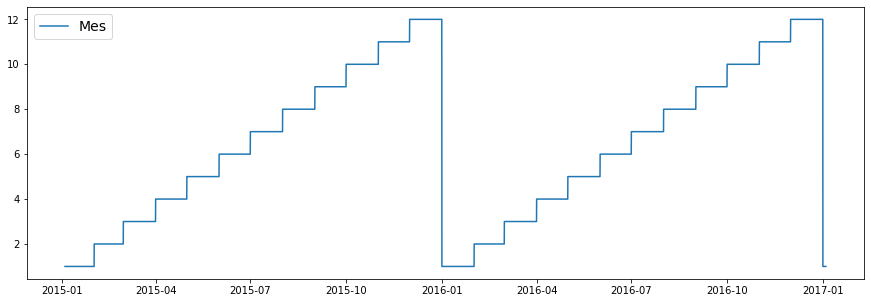

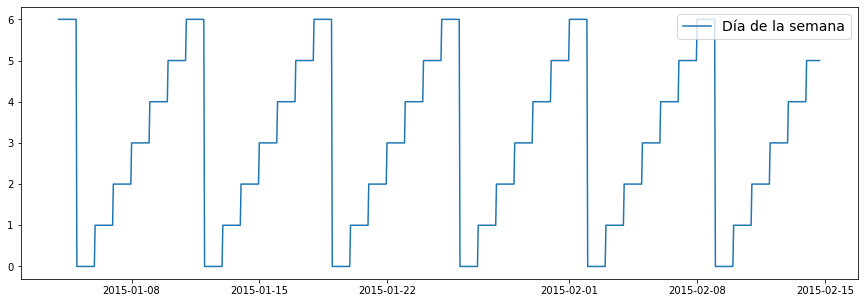

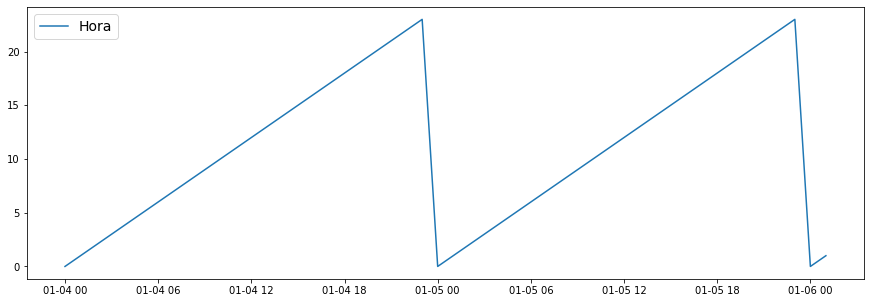

In [13]:
plt.figure(figsize=(15,5))
plt.plot(timestamp, mes, label='Mes')
plt.legend(fontsize=14);
plt.figure(figsize=(15,5))
plt.plot(timestamp[:1000], dia[:1000], label='Día de la semana')
plt.legend(fontsize=14);
plt.figure(figsize=(15,5))
plt.plot(timestamp[0:50], hora[0:50], label='Hora')
plt.legend(fontsize=14);

In [14]:
def encode_ciclicas(v, n_valores):
    x = np.cos(v/n_valores * 2*np.pi)
    y = np.sin(v/n_valores * 2*np.pi)
    return x, y

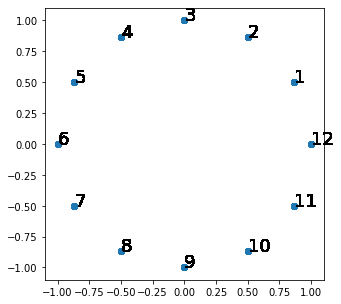

In [15]:
coords_x_mes, coords_y_mes = encode_ciclicas(mes, 12)
plt.figure(figsize=(5,5))
plt.plot(coords_x_mes, coords_y_mes, "o")
for cx,cy,texto in zip(coords_x_mes, coords_y_mes, mes):
    plt.text(cx,cy,texto, fontsize=18)

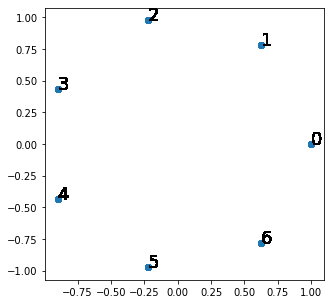

In [16]:
coords_x_day_of_week, coords_y_day_of_week = encode_ciclicas(dia, 7)
plt.figure(figsize=(5,5))
plt.plot(coords_x_day_of_week, coords_y_day_of_week, "o")
for cx,cy,texto in zip(coords_x_day_of_week, coords_y_day_of_week, dia):
    plt.text(cx,cy,texto, fontsize=18)

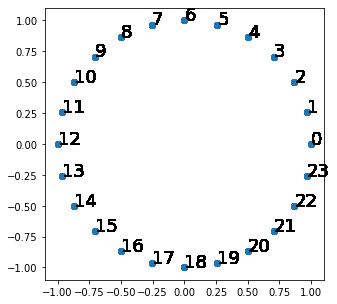

In [17]:
coords_x_hora, coords_y_hora = encode_ciclicas(hora, 24)
plt.figure(figsize=(5,5))
plt.plot(coords_x_hora, coords_y_hora, "o")
for cx,cy,texto in zip(coords_x_hora, coords_y_hora, hora):
    plt.text(cx,cy,texto, fontsize=18)

In [18]:

from sklearn.preprocessing import RobustScaler
f_columns = ['t1', 'hum', 'wind_speed']
f_transformer = RobustScaler()
f_transformer = f_transformer.fit(data[f_columns].to_numpy())
data.loc[:, f_columns] = f_transformer.transform(data[f_columns].to_numpy())

In [19]:
data.cnt.std()

1085.1080679362167

In [20]:
# Transformación de escala (ajustar el factor en función del problema)
def transform(x):
    return x/data.cnt.std()
def inverse_transform(x_escalado):
    return x_escalado*1085.10 #data.cnt.std()

In [21]:
def inverse_transform(x_escalado):
    return x_escalado*1085.10 #data.cnt.std()

In [22]:
data['cnt'] = transform(data['cnt'])

In [23]:
data['cnt'].max()

7.243518164000984

In [24]:
data.head(5)

,timestamp,cnt,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,season,hour,day_of_week,day_of_month,month,year,year_month
0,2015-01-04 00:00:00,0.167725,-1.1875,2.0,0.925,-0.857143,3.0,0.0,1.0,3.0,0,6,4,1,2015,2015-01
1,2015-01-04 01:00:00,0.127176,-1.1875,2.5,0.925,-0.952381,1.0,0.0,1.0,3.0,1,6,4,1,2015,2015-01
2,2015-01-04 02:00:00,0.123490,-1.2500,2.5,1.100,-1.428571,1.0,0.0,1.0,3.0,2,6,4,1,2015,2015-01
3,2015-01-04 03:00:00,0.066353,-1.3125,2.0,1.275,-1.428571,1.0,0.0,1.0,3.0,3,6,4,1,2015,2015-01
4,2015-01-04 04:00:00,0.043314,-1.3125,0.0,0.925,-0.809524,1.0,0.0,1.0,3.0,4,6,4,1,2015,2015-01


In [25]:
target = data['cnt'].values
t1 = data['t1'].values
t2 = data['t2'].values
hum = data['hum'].values
viento = data['wind_speed'].values
tiempo = data['weather_code'].values
festivo = data['is_holiday'].values
#is_weekend
#season
#year
mes = data['month'].values
dia = data['day_of_week'].values
hora = data['hour'].values

estacion = data['season'].values
festivo = data['is_holiday'].values
timestamp = data["timestamp"].values
year_month = data["year_month"].values

In [26]:
cnt	t1	t2	hum	wind_speed	weather_code	is_holiday	is_weekend	season	hour	day_of_week	day_of_month	month	year	year_month

SyntaxError: ignored

In [27]:
target_transf = transform(target)

series = [target_transf, t1, hum, viento, festivo]
se_saben_antes = [False, True, True, True, True]
nombres_series = ["target_transf", "t1", "hum", "wind_speed", "is_holiday"]

# Variables calendario sobre las que hemos la transformación cíclica
series.append(coords_x_mes)
nombres_series.append("coords_x_mes")
se_saben_antes.append(True)

series.append(coords_y_mes)
nombres_series.append("coords_y_mes")
se_saben_antes.append(True)

series.append(coords_x_hora)
nombres_series.append("coords_x_semana")
se_saben_antes.append(True)

series.append(coords_y_hora)
nombres_series.append("coords_y_hora")
se_saben_antes.append(True)

series.append(coords_x_day_of_week)
nombres_series.append("coords_x_dia")
se_saben_antes.append(True)

series.append(coords_y_day_of_week)
nombres_series.append("coords_y_dia")
se_saben_antes.append(True)

In [28]:
print(np.shape(series))
print(np.shape(se_saben_antes))

(11, 17414)
(11,)


In [29]:
series

[array([0.16772523, 0.12717627, 0.12349   , ..., 0.31056815, 0.20643105,
        0.12809784]),
 array([-1.1875, -1.1875, -1.25  , ..., -0.875 , -0.875 , -0.9375]),
 array([0.925, 0.925, 1.1  , ..., 0.2  , 0.075, 0.075]),
 array([-0.85714286, -0.95238095, -1.42857143, ...,  0.85714286,
         0.76190476,  0.66666667]),
 array([0., 0., 0., ..., 0., 0., 0.]),
 array([0.8660254, 0.8660254, 0.8660254, ..., 0.8660254, 0.8660254,
        0.8660254]),
 array([0.5, 0.5, 0.5, ..., 0.5, 0.5, 0.5]),
 array([1.        , 0.96592583, 0.8660254 , ..., 0.70710678, 0.8660254 ,
        0.96592583]),
 array([ 0.        ,  0.25881905,  0.5       , ..., -0.70710678,
        -0.5       , -0.25881905]),
 array([0.6234898, 0.6234898, 0.6234898, ..., 0.6234898, 0.6234898,
        0.6234898]),
 array([-0.78183148, -0.78183148, -0.78183148, ...,  0.78183148,
         0.78183148,  0.78183148])]

In [30]:
from my_utils_series_temporales import NAN, int2dummy, enventanar, info_enventanado

In [31]:
lookback = 48 # lookback es otro sinónimo de W_in (LAG)
time_step = 24 # valores a predecir (N_AHEAD, N_OUTPUTS)

# target=0 en siguiente línea quiere decir cuál es el índice del target en objeto "series":
X, y = enventanar(series, target=0, se_saben_antes=se_saben_antes,
                  W_in=lookback, W_out = time_step)

print(X.shape, np.shape(y))

(17414, 48, 11) (17414, 24)


In [32]:
print(X.shape)
print(np.shape(target))

(17414, 48, 11)
(17414,)


In [33]:
info_enventanado(X[:10],y[:10],
                 nombres_series=nombres_series,
                 nombre_target="target",
                 tiempos=timestamp)

10 ventanas creadas

X.shape=(10, 48, 11)  Y.shape=(10, 24) 

 Ventana 0: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,?44,?45,?46,?47
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490


 Ventana 1: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,?44,?45,?46,2015-01-04T00:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490


 Ventana 2: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,?44,?45,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490


 Ventana 3: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,?44,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490


 Ventana 4: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,?43,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 5: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,?42,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 6: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,?41,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000,2015-01-04T05:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314,0.042392
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500,-1.437500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000,1.275000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619,-0.761905
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819,0.000000
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926,1.000000
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 7: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,?40,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000,2015-01-04T05:00:00.000000000,2015-01-04T06:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314,0.042392,0.047000
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500,-1.437500,-1.437500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000,1.275000,1.275000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619,-0.761905,-0.761905
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819,0.000000,-0.258819
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926,1.000000,0.965926
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 8: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,?39,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000,2015-01-04T05:00:00.000000000,2015-01-04T06:00:00.000000000,2015-01-04T07:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314,0.042392,0.047000,0.069118
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500,-1.437500,-1.437500,-1.375000
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000,1.275000,1.275000,1.100000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619,-0.761905,-0.761905,-0.666667
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819,0.000000,-0.258819,-0.500000
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926,1.000000,0.965926,0.866025
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


 Ventana 9: 


,?0,?1,?2,?3,?4,?5,?6,?7,?8,?9,?10,?11,?12,?13,?14,?15,?16,?17,?18,?19,?20,?21,?22,?23,?24,?25,?26,?27,?28,?29,?30,?31,?32,?33,?34,?35,?36,?37,?38,2015-01-04T00:00:00.000000000,2015-01-04T01:00:00.000000000,2015-01-04T02:00:00.000000000,2015-01-04T03:00:00.000000000,2015-01-04T04:00:00.000000000,2015-01-04T05:00:00.000000000,2015-01-04T06:00:00.000000000,2015-01-04T07:00:00.000000000,2015-01-04T08:00:00.000000000
target_transf,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.167725,0.127176,0.123490,0.066353,0.043314,0.042392,0.047000,0.069118,0.120725
t1,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-1.187500,-1.187500,-1.250000,-1.312500,-1.312500,-1.312500,-1.437500,-1.437500,-1.375000,-1.312500
hum,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.925000,0.925000,1.100000,1.275000,0.925000,0.925000,1.275000,1.275000,1.100000,1.275000
wind_speed,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,-0.857143,-0.952381,-1.428571,-1.428571,-0.809524,-1.047619,-0.761905,-0.761905,-0.666667,-0.571429
is_holiday,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
coords_x_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025,0.866025
coords_y_mes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
coords_x_semana,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.965926,0.866025,0.707107,0.500000,0.258819,0.000000,-0.258819,-0.500000,-0.707107
coords_y_hora,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.000000,0.258819,0.500000,0.707107,0.866025,0.965926,1.000000,0.965926,0.866025,0.707107
coords_x_dia,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490,0.623490


In [34]:
y.shape

(17414, 24)

In [35]:
y2 = y[:-24] #elimino los últimos time_step al tener NAN
X2 = X[:-24]#elimino los últimos time_step al tener NAN
target2 = target[:-24] #elimino los últimos time_step al tener NAN
timestamp2 = timestamp[:-24] #elimino los últimos time_step al tener NAN

In [36]:
print(y2.shape)
print(X2.shape)
print(target2.shape)
print(timestamp2.shape)

(17390, 24)
(17390, 48, 11)
(17390,)
(17390,)


 Separación training-test

In [37]:
train_perc  = .8
punto_corte = int(len(X)*train_perc)


X_train      = X2[lookback:punto_corte]      # elimino los lookback primeros al tener NANs
y_train      = y2[lookback:punto_corte]      # elimino los lookback primeros al tener NANs
target_train = target2[lookback:punto_corte] # elimino los lookback primeros al tener NANs
fechas_train = timestamp2[lookback:punto_corte] # elimino los lookback primeros al tener NANs

X_test       = X[punto_corte:]
y_test       = y[punto_corte:]
target_test  = target[punto_corte:]
fechas_test  = timestamp2[punto_corte:]

print(np.shape(target_train))
print(np.shape(target_test))

(13883,)
(3483,)


In [38]:
len(target_test) + len(target_train)

17366

In [40]:
from pandas import DataFrame

In [42]:
DataFrame(fechas_train)

,0
0,2015-01-06 00:00:00
1,2015-01-06 01:00:00
2,2015-01-06 02:00:00
3,2015-01-06 03:00:00
4,2015-01-06 04:00:00
...,...
13878,2016-08-09 22:00:00
13879,2016-08-09 23:00:00
13880,2016-08-10 00:00:00
13881,2016-08-10 01:00:00


In [41]:
DataFrame(fechas_test)

,0
0,2016-08-10 03:00:00
1,2016-08-10 04:00:00
2,2016-08-10 05:00:00
3,2016-08-10 06:00:00
4,2016-08-10 07:00:00
...,...
3454,2017-01-02 19:00:00
3455,2017-01-02 20:00:00
3456,2017-01-02 21:00:00
3457,2017-01-02 22:00:00


In [40]:
print(X_train.shape, y_train.shape)

(13883, 48, 11) (13883, 24)


In [41]:
lookback, X_train.shape[-1]

(48, 11)

 Construcción del modelo con Keras

In [43]:
def vanilla_multistep_LSTM():
    model = Sequential()  
    model.add(LSTM(units=50, input_shape=(lookback, X_train.shape[-1])))
    model.add(Dense(time_step))
    return model

In [44]:
loss = 'mean_squared_error'
optimizer = "adam"

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score as R2_score

In [45]:
model = vanilla_multistep_LSTM()
model.summary()
model.compile(optimizer=optimizer, 
              loss=loss,
              metrics=['mse'])

import keras.backend as K
print(K.get_value(model.optimizer.lr))

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 50)                12400     
                                                                 
 dense (Dense)               (None, 24)                1224      
                                                                 
Total params: 13,624
Trainable params: 13,624
Non-trainable params: 0
_________________________________________________________________
0.001


In [46]:
history_model_0 = model.fit(X_train, y_train, epochs=35, validation_split=0.1, batch_size=32)

Epoch 1/35
179/391 [============>.................] - ETA: 5s - loss: 0.7804 - mse: 0.7804

KeyboardInterrupt: ignored

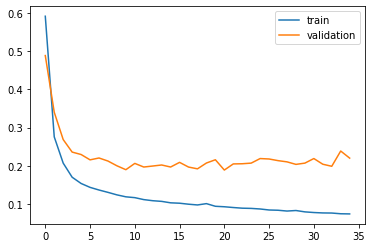

In [43]:
plt.plot(history_model_0.history['loss'], label='train')
plt.plot(history_model_0.history['val_loss'], label='validation')
plt.legend()
plt.show()

In [ ]:
#lookback  ---> n_lag
#time_step ---> n_seq

In [101]:
from math import sqrt
from sklearn.metrics import mean_squared_error

In [150]:
np.sqrt(mean_squared_error(y_test[:,0], y_pred[:,0]))

0.21047095936569654

In [189]:
from pandas import DataFrame

In [200]:
y_test[0:-23, 23]

array([0.10598023, 0.08478418, 0.06911754, ..., 0.31056815, 0.20643105,
       0.12809784])

In [192]:
DataFrame(y_test).tail(23)

,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
3460,0.045157,0.039627,0.009216,0.027647,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,...,0.778724,1.106802,2.526937,2.045879,0.960273,0.498568,0.310568,0.206431,0.128098,NaN
3461,0.039627,0.009216,0.027647,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,...,1.106802,2.526937,2.045879,0.960273,0.498568,0.310568,0.206431,0.128098,NaN,NaN
3462,0.009216,0.027647,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,...,2.526937,2.045879,0.960273,0.498568,0.310568,0.206431,0.128098,NaN,NaN,NaN
3463,0.027647,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,...,2.045879,0.960273,0.498568,0.310568,0.206431,0.128098,NaN,NaN,NaN,NaN
3464,0.076490,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,...,0.960273,0.498568,0.310568,0.206431,0.128098,NaN,NaN,NaN,NaN,NaN
3465,0.399960,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,...,0.498568,0.310568,0.206431,0.128098,NaN,NaN,NaN,NaN,NaN,NaN
3466,1.296645,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,1.106802,...,0.310568,0.206431,0.128098,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3467,2.676231,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,1.106802,2.526937,...,0.206431,0.128098,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3468,1.250567,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,1.106802,2.526937,2.045879,...,0.128098,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3469,0.609156,0.586117,0.760293,0.809136,0.704999,0.778724,1.106802,2.526937,2.045879,0.960273,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [201]:

y_test = y_test[0:-23, :]
y_pred = y_pred[0:-23, :]

In [157]:
range(len(y_pred[0,:]))

range(0, 24)

In [205]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test[:,i], y_pred[:,i])))

Train RMSE: 0.21096691906288295
Train RMSE: 0.2815853571794673
Train RMSE: 0.3221875598651247
Train RMSE: 0.3378299446748575
Train RMSE: 0.3557862584872255
Train RMSE: 0.3734464616397417
Train RMSE: 0.3745183224240445
Train RMSE: 0.39314829673162544
Train RMSE: 0.40778009626734146
Train RMSE: 0.41682679923162996
Train RMSE: 0.42671020938022325
Train RMSE: 0.4373848472131894
Train RMSE: 0.4400462633911701
Train RMSE: 0.44067147472424995
Train RMSE: 0.4423203957703585
Train RMSE: 0.4356732586763892
Train RMSE: 0.44191986344453094
Train RMSE: 0.43799949021077195
Train RMSE: 0.4380750924169367
Train RMSE: 0.4507863018767966
Train RMSE: 0.4545100270739162
Train RMSE: 0.4461338810086205
Train RMSE: 0.44620408655729055
Train RMSE: 0.443252140452875


Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

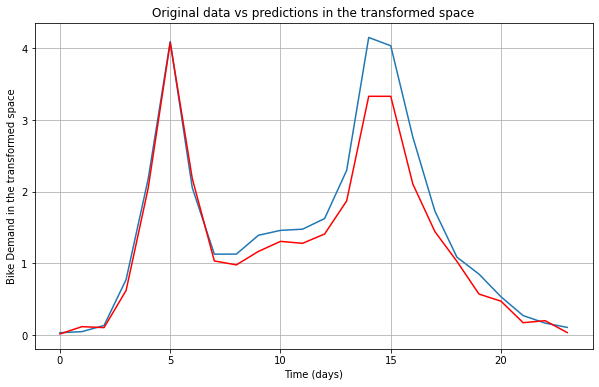

In [ ]:
# Prediction
y_pred = model.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_day = 0
y_pred_days = y_pred[the_day,:]

plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (days)')
plt.ylabel('Bike Demand in the transformed space')
plt.title('Original data vs predictions in the transformed space')

In [ ]:
n_timesteps, n_features, n_outputs = X_train.shape[1], X_train.shape[2], y_train.shape[1]

In [ ]:
model_0 = Sequential()
model_0.add(LSTM(200, activation='relu', input_shape=(n_timesteps, n_features)))  # input_shape=[time steps, features]
model_0.add(Dense(100, activation='relu'))
model_0.add(Dense(n_outputs))
model_0.compile(loss='mean_squared_error', metrics=['mse'], optimizer='adam')

In [ ]:
model_0.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_10 (LSTM)              (None, 200)               169600    
                                                                 
 dense_11 (Dense)            (None, 100)               20100     
                                                                 
 dense_12 (Dense)            (None, 24)                2424      
                                                                 
Total params: 192,124
Trainable params: 192,124
Non-trainable params: 0
_________________________________________________________________


In [ ]:
history_model_0 = model_0.fit(X_train, y_train, epochs=35, validation_split=0.1, batch_size=32)

Epoch 1/35
391/391 [==============================] - 45s 110ms/step - loss: nan - mse: nan - val_loss: nan - val_mse: nan
Epoch 2/35
159/391 [===========>..................] - ETA: 23s - loss: nan - mse: nan

KeyboardInterrupt: ignored

probando

In [1]:
# Prediction
y_pred = model.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_hour = 0
y_pred_hour = y_pred[the_day,:]


NameError: ignored

In [ ]:
y_pred

array([[-0.05594212, -0.01673202,  0.26441845, ...,  0.19075108,
         0.20941885, -0.01141405],
       [ 0.01078567,  0.19675684,  0.7828093 , ...,  0.12865308,
        -0.02761573, -0.02626342],
       [ 0.15965058,  0.79480594,  2.4489532 , ...,  0.07361817,
         0.20814891,  0.09050679],
       ...,
       [ 0.45599782,  0.38918313,  0.3346392 , ...,  1.9591632 ,
         1.0967755 ,  0.5487582 ],
       [ 0.29884946,  0.22998245,  0.1809567 , ...,  1.0417607 ,
         0.6263505 ,  0.45428747],
       [ 0.22318567,  0.12923798,  0.05836874, ...,  0.66363704,
         0.40307012,  0.17764473]], dtype=float32)

KeyboardInterrupt: ignored

Exception ignored in: 'zmq.backend.cython.message.Frame.__dealloc__'
Traceback (most recent call last):
  File "zmq/backend/cython/checkrc.pxd", line 13, in zmq.backend.cython.checkrc._check_rc
KeyboardInterrupt
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipy

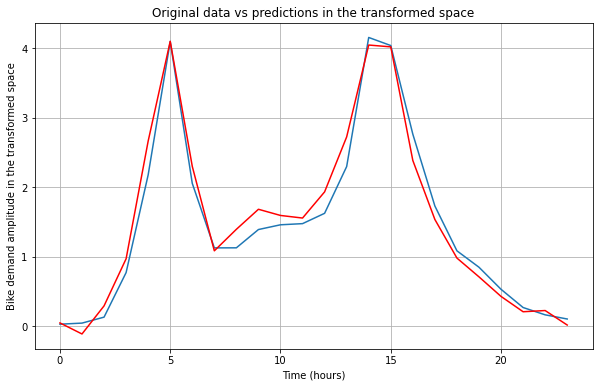

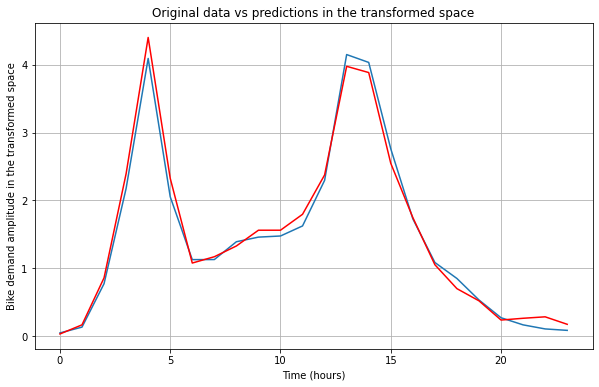

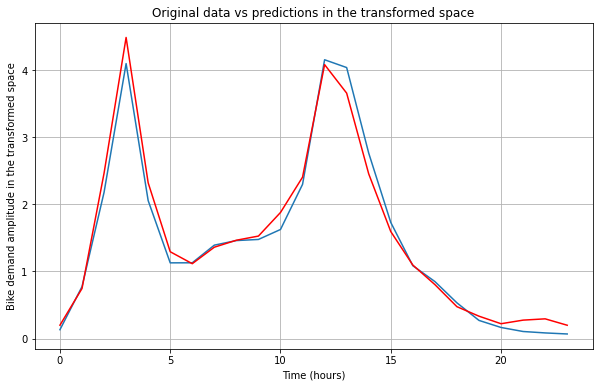

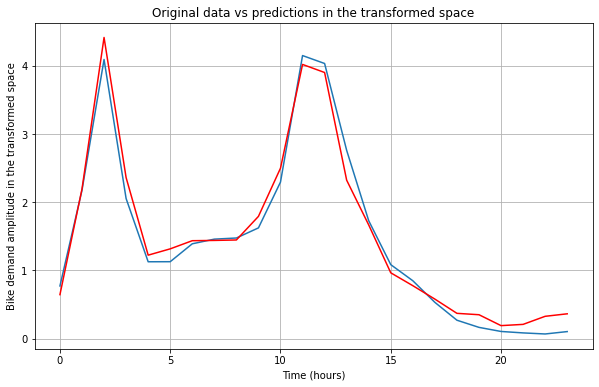

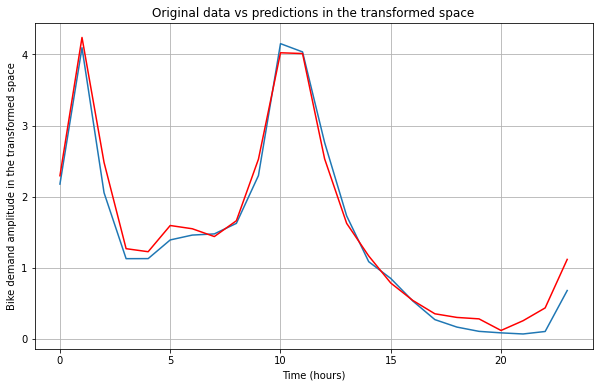

...

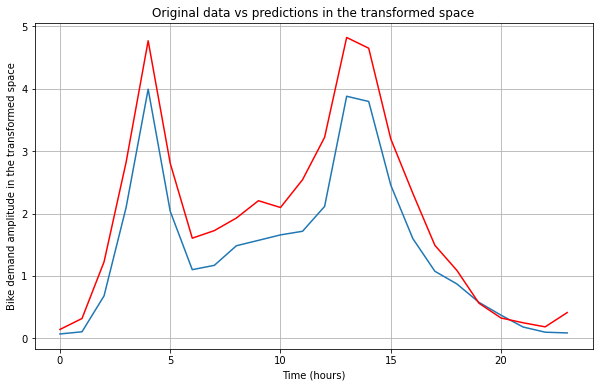

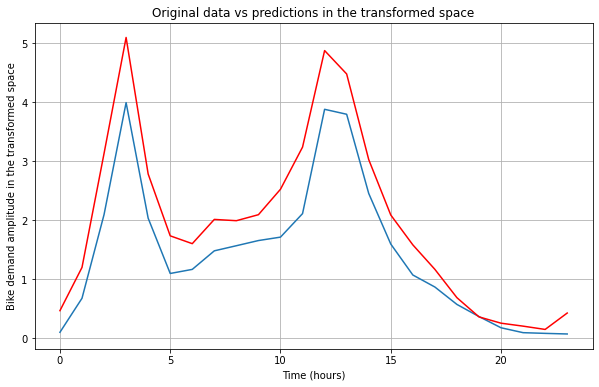

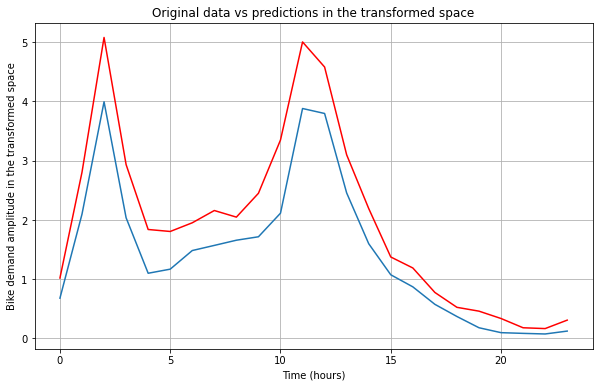

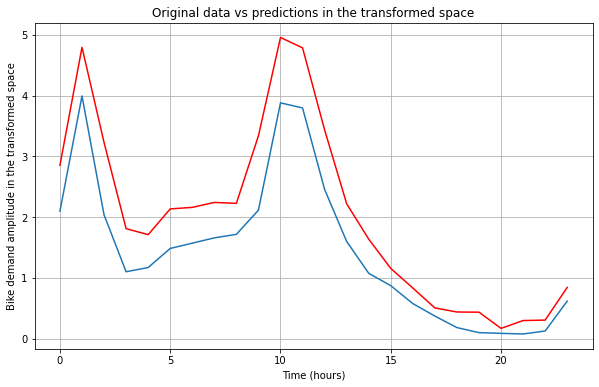

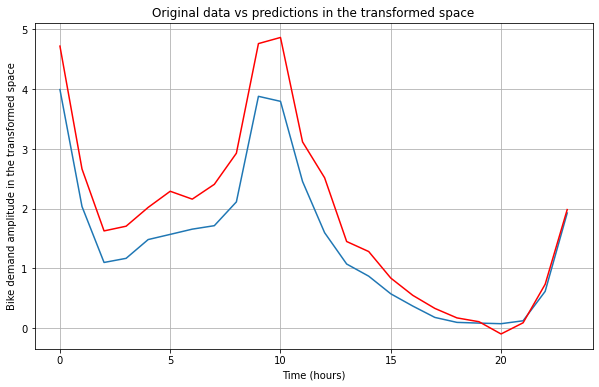

In [209]:
for i in range(0,30):
  the_day = i
  y_pred_days = y_pred[the_day,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_day,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

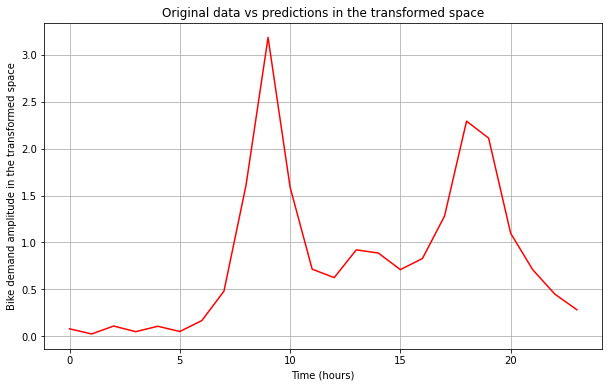

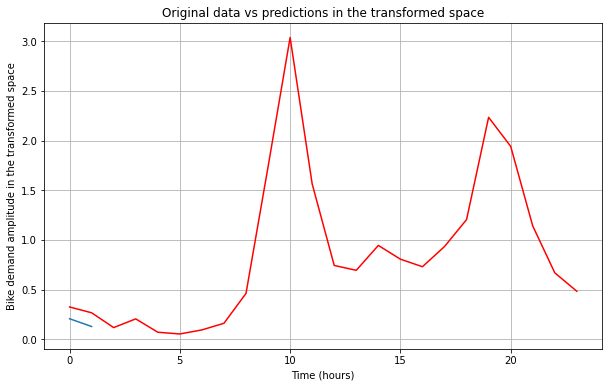

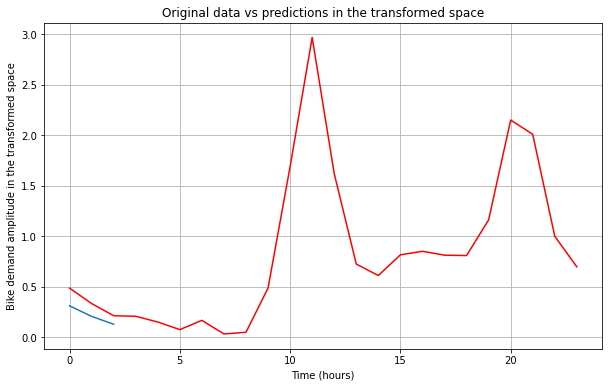

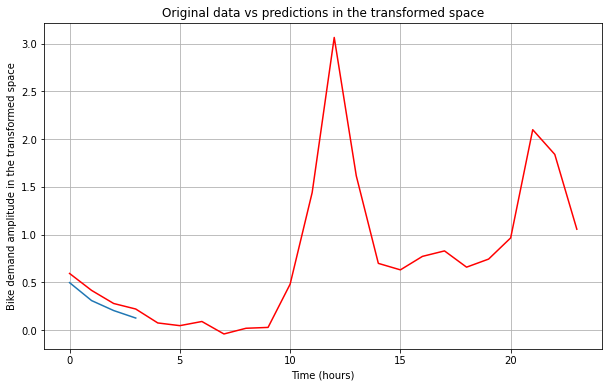

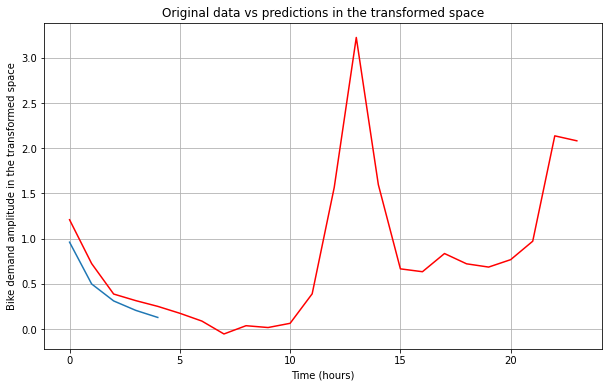

...

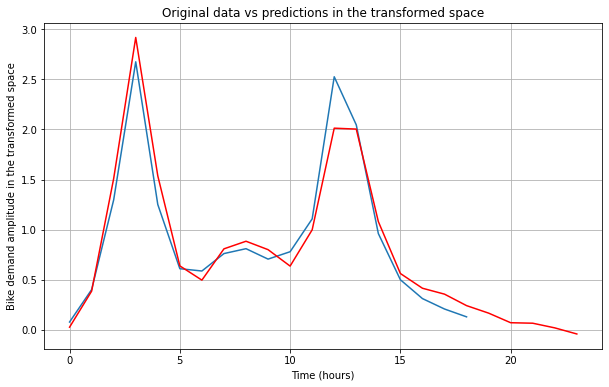

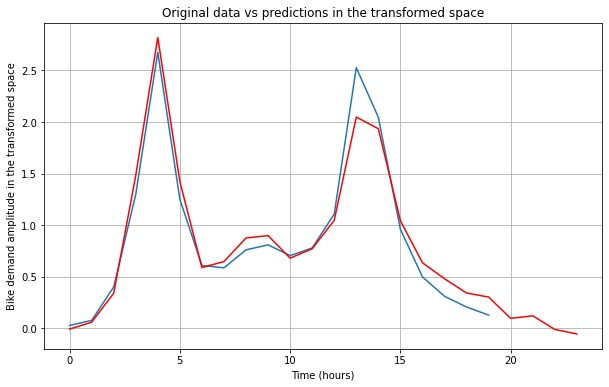

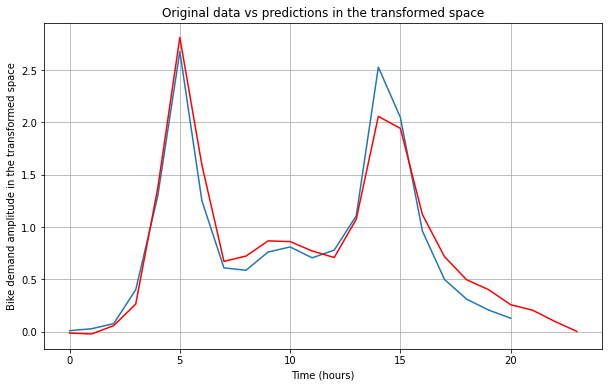

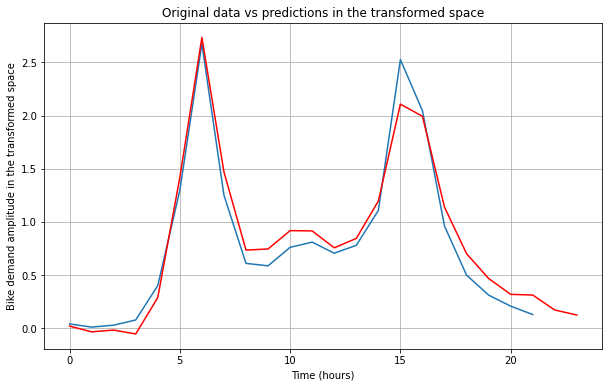

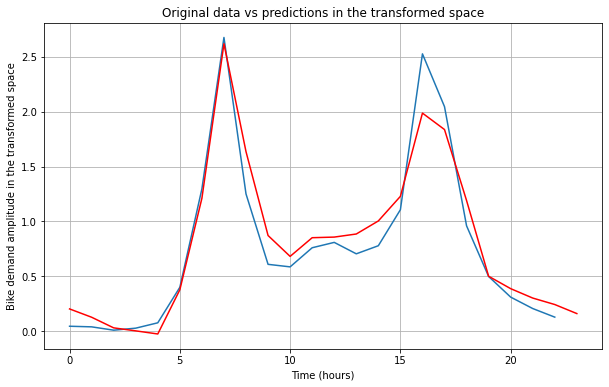

In [ ]:
for i in range(1,24):
  the_hour = -i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

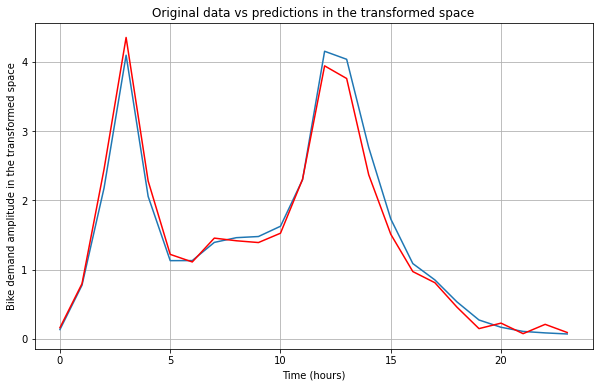

In [ ]:
the_day = 2
y_pred_days = y_pred[the_day,:]

plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (hours)')
plt.ylabel('Bike demand amplitude in the transformed space')
plt.title('Original data vs predictions in the transformed space')

Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

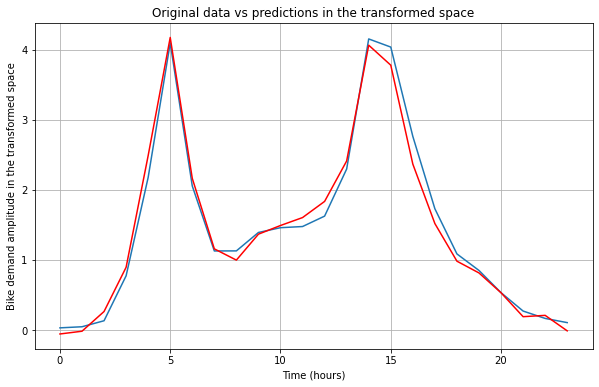

In [ ]:
the_day = 0
plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (hours)')
plt.ylabel('Bike demand amplitude in the transformed space')
plt.title('Original data vs predictions in the transformed space')

Chequeo

In [ ]:
y_train_prediction = model.predict(X_train)
y_test_prediction = model.predict(X_test)

In [ ]:
y_train_prediction.shape

(13883, 24)

In [ ]:
target_train_pred = inverse_transform(y_train_prediction)
target_test_pred  = inverse_transform(y_test_prediction)

In [ ]:
y_test_inv = inverse_transform(y_test)

In [ ]:
target_train_pred.shape

(13883, 24)

In [ ]:
y_train_prediction

array([[ 0.11859745,  0.12764654,  0.04211043, ...,  0.56862533,
         0.41495246,  0.29291603],
       [ 0.02799015,  0.0485474 ,  0.04224458, ...,  0.48202094,
         0.2922027 ,  0.19090441],
       [ 0.0343588 ,  0.04386388, -0.00711916, ...,  0.31824735,
         0.12140697,  0.11433038],
       ...,
       [ 0.1472924 ,  0.06550334,  0.11861002, ...,  0.80561507,
         0.70152545,  0.7037877 ],
       [-0.02739336, -0.00685152, -0.03452538, ...,  0.57948756,
         0.3002407 ,  0.2859222 ],
       [-0.15073834, -0.00273833,  0.04724509, ...,  0.449693  ,
         0.14806886,  0.15408781]], dtype=float32)

In [ ]:
target_train_pred

array([[ 128.6901   ,  138.50925  ,   45.694023 , ...,  617.0153   ,
         450.2649   ,  317.84317  ],
       [  30.372108 ,   52.678783 ,   45.839596 , ...,  523.0409   ,
         317.06915  ,  207.15038  ],
       [  37.282734 ,   47.59669  ,   -7.7250047, ...,  345.3302   ,
         131.73871  ,  124.05989  ],
       ...,
       [ 159.82698  ,   71.077675 ,  128.70374  , ...,  874.1729   ,
         761.2252   ,  763.68     ],
       [ -29.72453  ,   -7.4345884,  -37.46349  , ...,  628.80194  ,
         325.79117  ,  310.25418  ],
       [-163.56618  ,   -2.9713583,   51.26564  , ...,  487.96185  ,
         160.66951  ,  167.20068  ]], dtype=float32)

In [ ]:
# Parece que me salen predicciones negativas y no pueden haberlas, como mucho tendríamos predicciones en 0 (días de tormenta)

Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

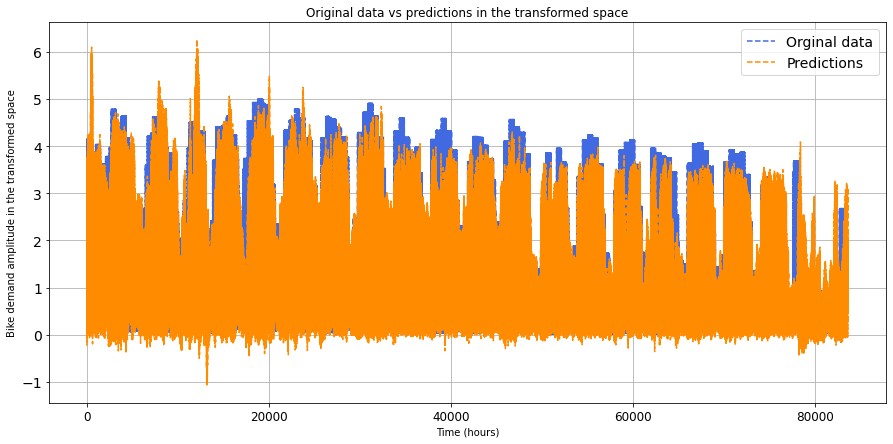

In [ ]:
y_ = y_test.flatten()
y_pred_days_ = y_pred_days.flatten()

plt.figure(figsize=(15,7))
plt.grid(True)
plt.plot(y_test.flatten(),'--', c='royalblue', label='Orginal data')
plt.plot(y_test_prediction.flatten(), '--', c='darkorange', label='Predictions')
plt.xticks(fontsize=12)
plt.yticks(fontsize=14)
#plt.xlim([fechas_train[100],fechas_train[200]])
plt.legend(fontsize=14);

plt.xlabel('Time (hours)')
plt.ylabel('Bike demand amplitude in the transformed space')
plt.title('Original data vs predictions in the transformed space')

# LSTM multiple

In [47]:
def multistep_LSTM():

  # The LSTM architecture
  model = Sequential()
  # First LSTM layer with Dropout regularisation
  model.add(LSTM(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1])))
  model.add(Dropout(0.2))
  # Second LSTM layer
  #model.add(LSTM(units=50, return_sequences=True))
  #model.add(Dropout(0.2))
  # Third LSTM layer
  model.add(LSTM(units=50, return_sequences=True))
  model.add(Dropout(0.2))
  # Fourth LSTM layer
  model.add(LSTM(units=50))
  model.add(Dropout(0.2))
  # The output layer
  model.add(Dense(time_step))
  return model

In [48]:
loss = 'mean_squared_error'
optimizer = "adam"

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score as R2_score

In [49]:
model_2 = multistep_LSTM()
model_2.summary()
model_2.compile(optimizer=optimizer, 
              loss=loss,
              metrics=['mse'])

import keras.backend as K
print(K.get_value(model_2.optimizer.lr))

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 48, 50)            12400     
                                                                 
 dropout (Dropout)           (None, 48, 50)            0         
                                                                 
 lstm_2 (LSTM)               (None, 48, 50)            20200     
                                                                 
 dropout_1 (Dropout)         (None, 48, 50)            0         
                                                                 
 lstm_3 (LSTM)               (None, 50)                20200     
                                                                 
 dropout_2 (Dropout)         (None, 50)                0         
                                                                 
 dense_1 (Dense)             (None, 24)               

In [ ]:
history_model_2 = model_2.fit(X_train, y_train, epochs=25, validation_split=0.1, batch_size=1)

Epoch 1/25
12494/12494 [==============================] - 505s 40ms/step - loss: 0.2030 - mse: 0.2030 - val_loss: 0.2816 - val_mse: 0.2816
Epoch 2/25
12494/12494 [==============================] - 502s 40ms/step - loss: 0.1637 - mse: 0.1637 - val_loss: 0.2785 - val_mse: 0.2785
Epoch 3/25
12494/12494 [==============================] - 499s 40ms/step - loss: 0.1488 - mse: 0.1488 - val_loss: 0.2593 - val_mse: 0.2593
Epoch 4/25
12494/12494 [==============================] - 498s 40ms/step - loss: 0.1331 - mse: 0.1331 - val_loss: 0.2503 - val_mse: 0.2503
Epoch 5/25
12494/12494 [==============================] - 498s 40ms/step - loss: 0.1269 - mse: 0.1269 - val_loss: 0.2397 - val_mse: 0.2397
Epoch 6/25
12494/12494 [==============================] - 502s 40ms/step - loss: 0.1184 - mse: 0.1184 - val_loss: 0.2743 - val_mse: 0.2743
Epoch 7/25
12494/12494 [==============================] - 505s 40ms/step - loss: 0.1118 - mse: 0.1118 - val_loss: 0.3038 - val_mse: 0.3038
Epoch 8/25
12494/12494 [===

In [1]:
plt.plot(history_model_2.history['loss'], label='train')
plt.plot(history_model_2.history['val_loss'], label='validation')
plt.legend()
plt.show()

NameError: ignored

In [ ]:
# Evaluate the model on the test set
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test[:,i], y_pred[:,i])))

Evaluate on test data
109/109 [==============================] - 1s 11ms/step - loss: nan - mse: nan 
Test MSE: nan
Test MAE: nan


Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

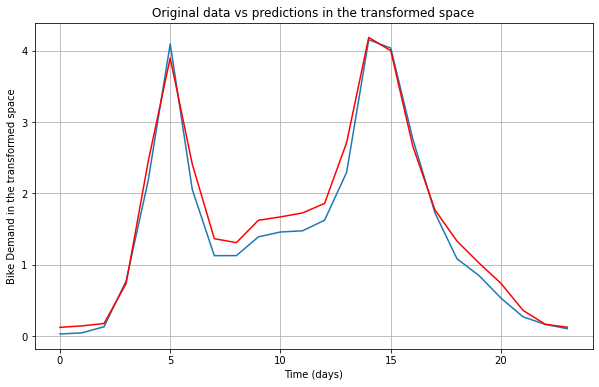

In [ ]:
# Prediction
y_pred = model_2.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_day = 0
y_pred_days = y_pred[the_day,:]

plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (days)')
plt.ylabel('Bike Demand in the transformed space')
plt.title('Original data vs predictions in the transformed space')

In [ ]:
# evaluate the RMSE for each forecast time step
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
	for i in range(n_seq):
		actual = test[:,(n_lag+i)]
		predicted = [forecast[i] for forecast in forecasts]
		rmse = sqrt(mean_squared_error(actual, predicted))
		print('t+%d RMSE: %f' % ((i+1), rmse))

In [ ]:
lookback

48

In [ ]:
n_outputs

24

In [ ]:
# Prediction
y_pred = model_2.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_hour = 0
y_pred_hour = y_pred[the_day,:]


In [ ]:
y_test.shape

(3483, 24)

In [ ]:
y_pred.shape

(3483, 24)

In [ ]:
from math import sqrt

In [ ]:
evaluate_forecasts(y_test, y_pred, lookback, n_outputs)

IndexError: ignored

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

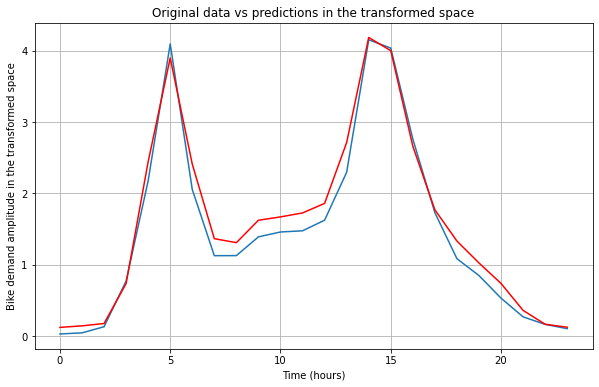

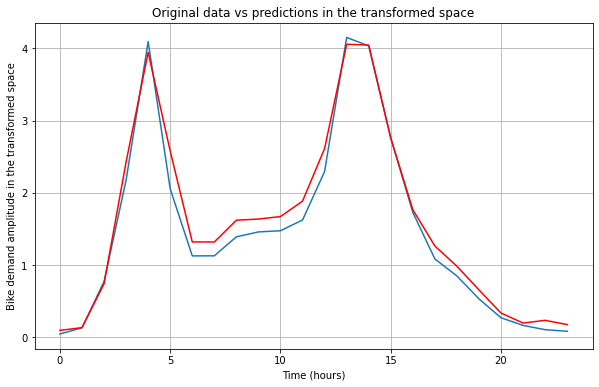

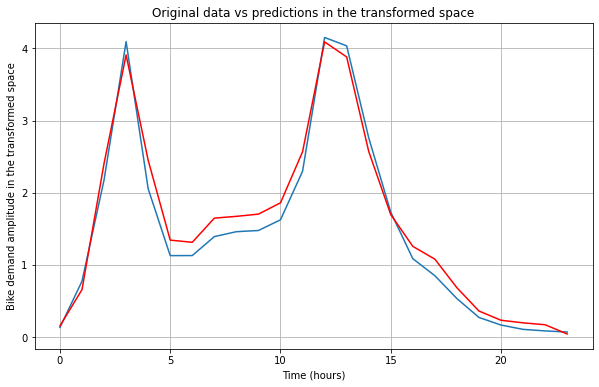

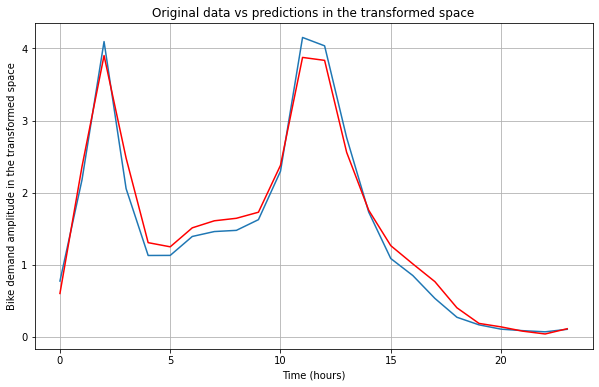

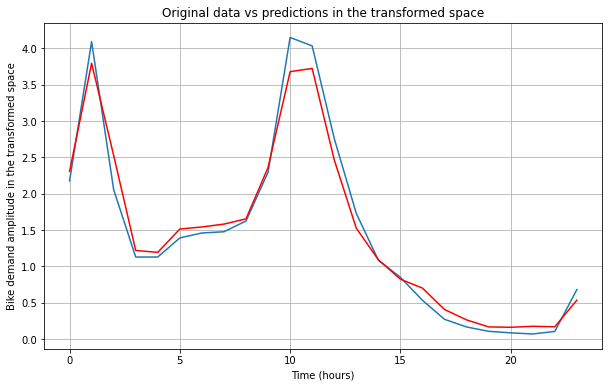

...

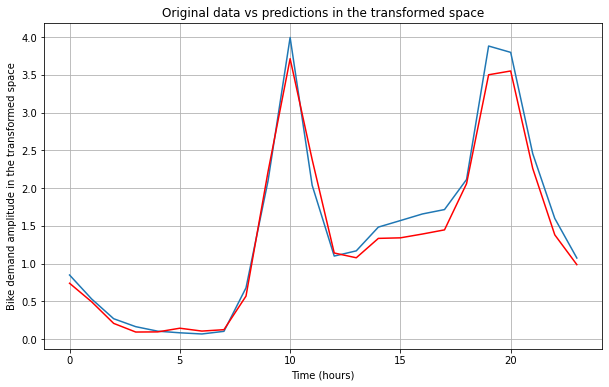

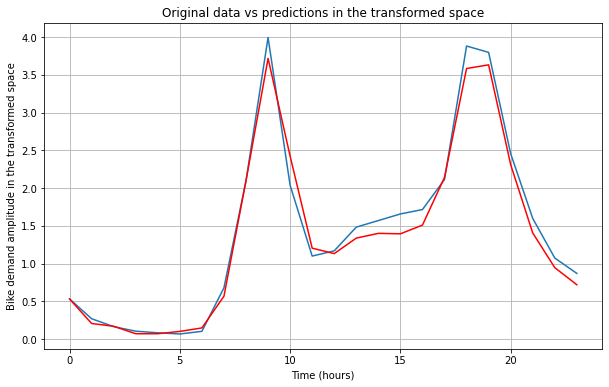

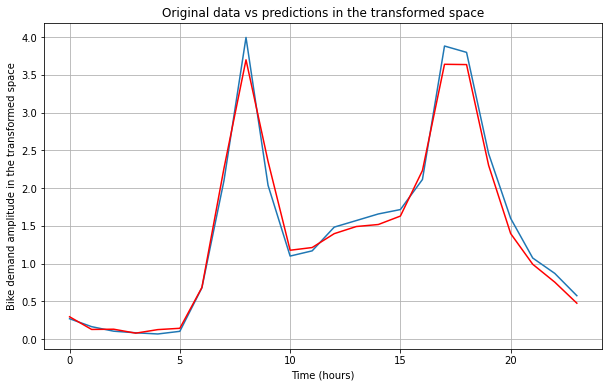

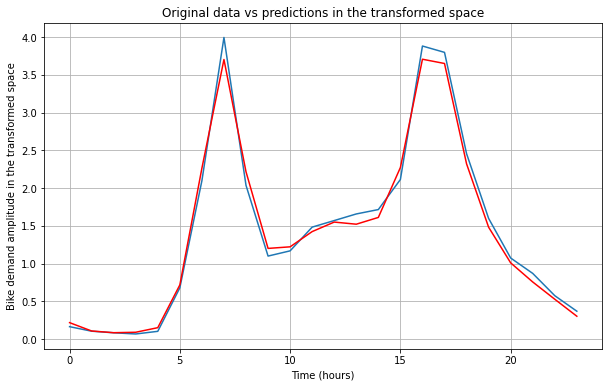

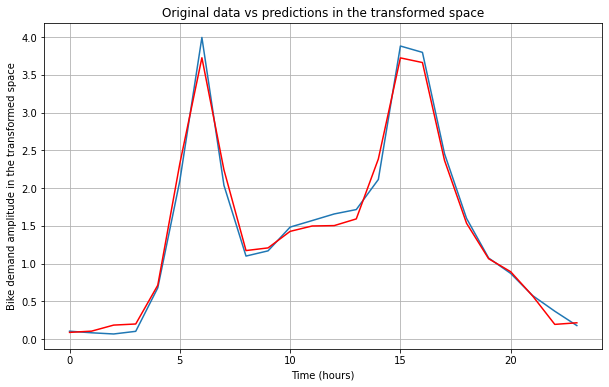

In [ ]:
for i in range(0,24):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

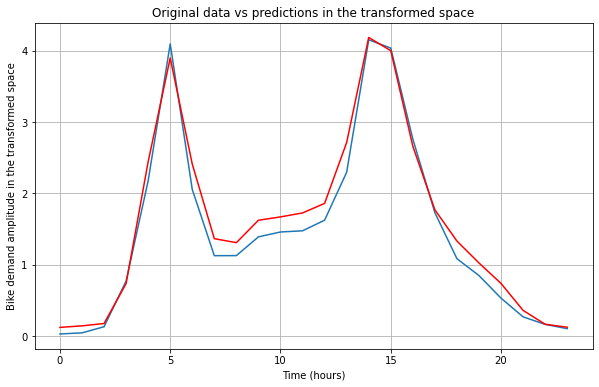

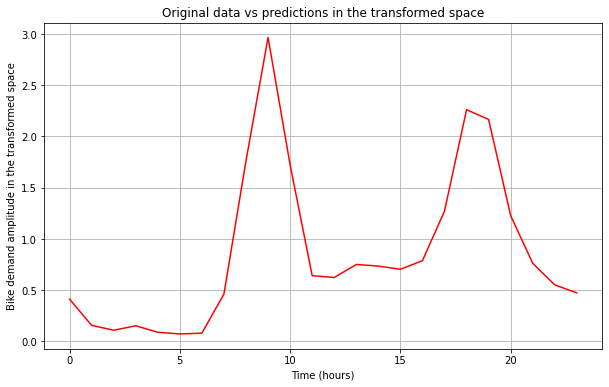

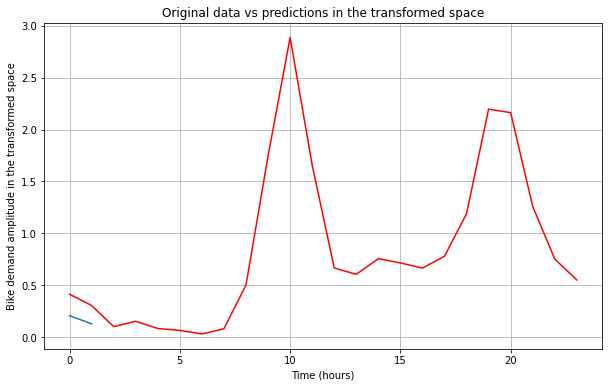

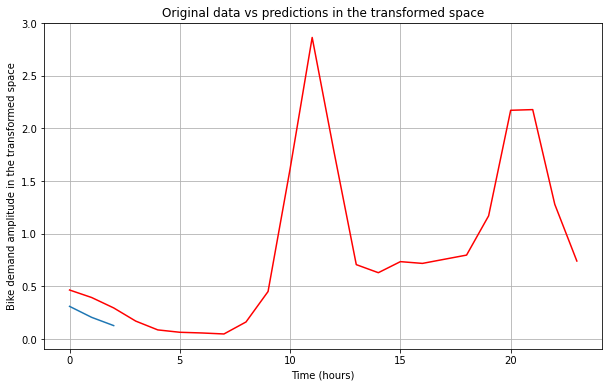

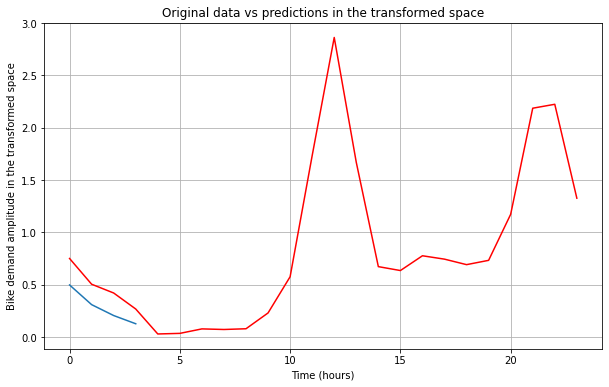

...

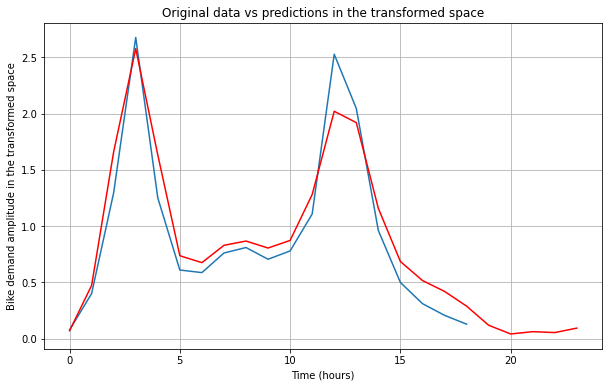

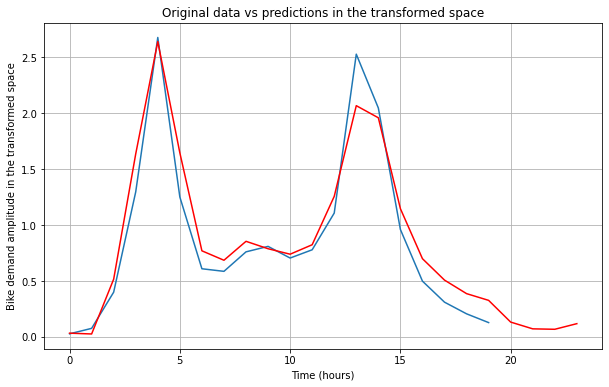

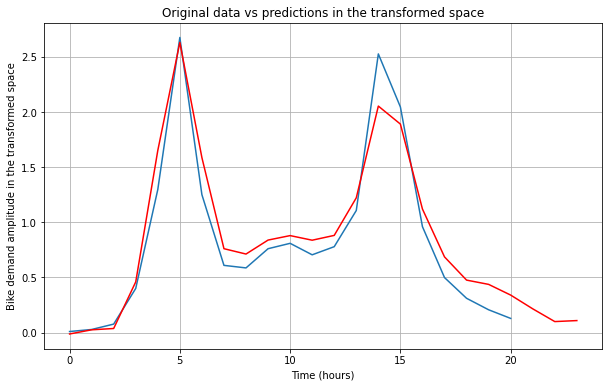

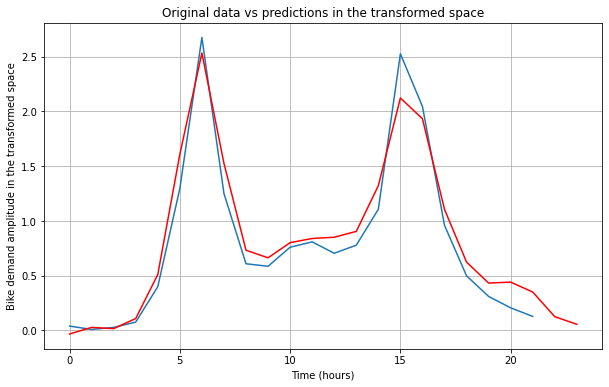

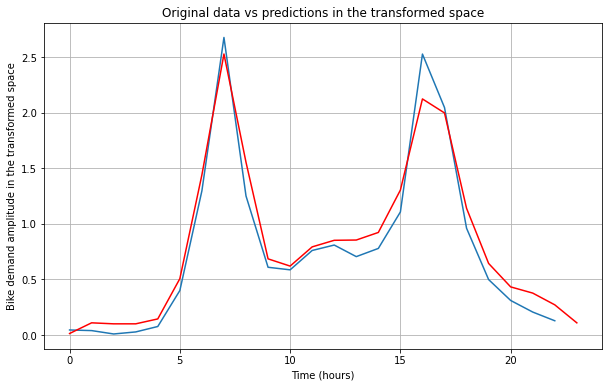

In [ ]:
for i in range(0,24):
  the_hour = -i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

# GRU

In [ ]:
time_step

24

In [66]:
def GRU():
  model= Sequential()
  model.add(GRU(units = 64, input_shape=(lookback, X_train.shape[-1])))
  model.add(Dense(units = 64, activation = 'relu'))
  model.add(Dropout(0.2))
  #model.add(GRU(units = 64))
  #model.add(Dropout(0.2))
  model.add(Dense(units = time_step))
  
  return model

In [67]:
from keras.layers import GRU

In [69]:
model_gru = Sequential()
model_gru.add(GRU(32, input_shape=(lookback, X_train.shape[-1])))
model_gru.add(Dense(units = 512, activation = 'relu'))
model_gru.add(Dropout(0.2))
model_gru.add(Dense(units = time_step, activation = 'linear'))
model_gru.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_1 (GRU)                 (None, 32)                4320      
                                                                 
 dense_2 (Dense)             (None, 512)               16896     
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_3 (Dense)             (None, 24)                12312     
                                                                 
Total params: 33,528
Trainable params: 33,528
Non-trainable params: 0
_________________________________________________________________


In [49]:
loss = 'mean_squared_error'
optimizer = "adam"

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score as R2_score

In [68]:
model_gru = GRU()
model_gru.summary()
model_gru.compile(optimizer=optimizer, 
              loss=loss,
              metrics=['mse'])

import keras.backend as K
print(K.get_value(model_gru.optimizer.lr))

TypeError: ignored

In [70]:
model_gru.compile(optimizer=optimizer, 
              loss=loss,
              metrics=['mse'])

#import keras.backend as K
#print(K.get_value(model_gru.optimizer.lr))

In [71]:
history_model_3 = model_gru.fit(X_train, y_train, epochs=25, validation_split=0.1, batch_size=32)

Epoch 1/25
391/391 [==============================] - 9s 17ms/step - loss: 0.4784 - mse: 0.4784 - val_loss: 0.3564 - val_mse: 0.3564
Epoch 2/25
391/391 [==============================] - 6s 16ms/step - loss: 0.2524 - mse: 0.2524 - val_loss: 0.2536 - val_mse: 0.2536
Epoch 3/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1969 - mse: 0.1969 - val_loss: 0.2367 - val_mse: 0.2367
Epoch 4/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1738 - mse: 0.1738 - val_loss: 0.2041 - val_mse: 0.2041
Epoch 5/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1595 - mse: 0.1595 - val_loss: 0.2174 - val_mse: 0.2174
Epoch 6/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1505 - mse: 0.1505 - val_loss: 0.1851 - val_mse: 0.1851
Epoch 7/25
391/391 [==============================] - 6s 16ms/step - loss: 0.1444 - mse: 0.1444 - val_loss: 0.1782 - val_mse: 0.1782
Epoch 8/25
391/391 [==============================] - 6s 16ms/step - 

In [72]:
# Prediction
y_pred = model_gru.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_day = 0
y_pred_hour = y_pred[the_day,:]


In [82]:
y_pred.shape

(3483, 24)

In [86]:
3483/9

387.0

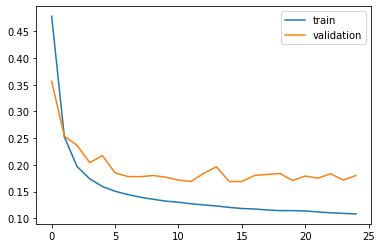

In [73]:
plt.plot(history_model_3.history['loss'], label='train')
plt.plot(history_model_3.history['val_loss'], label='validation')
plt.legend()
plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

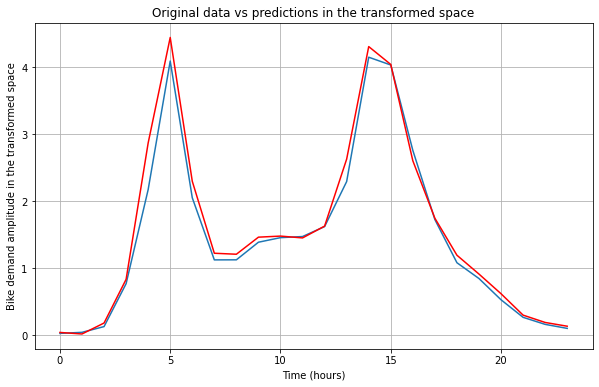

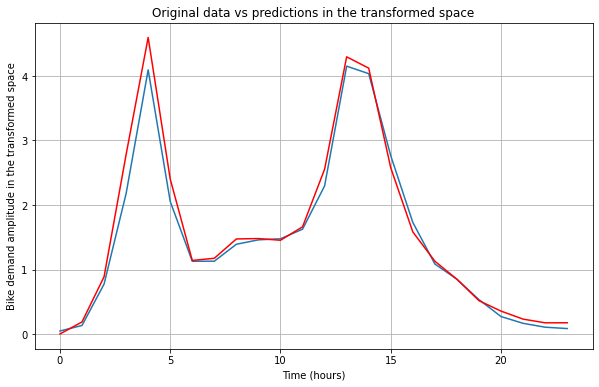

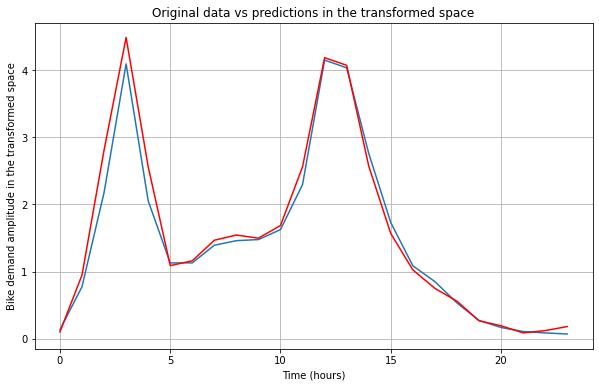

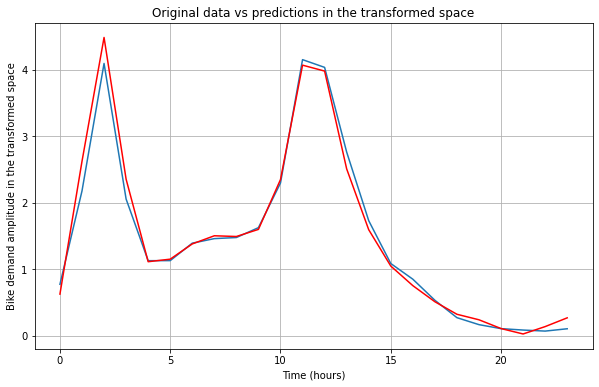

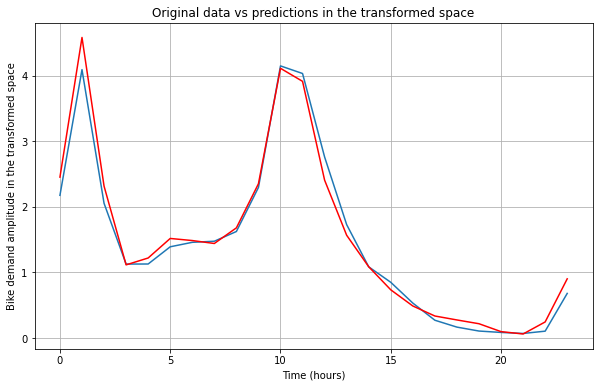

...

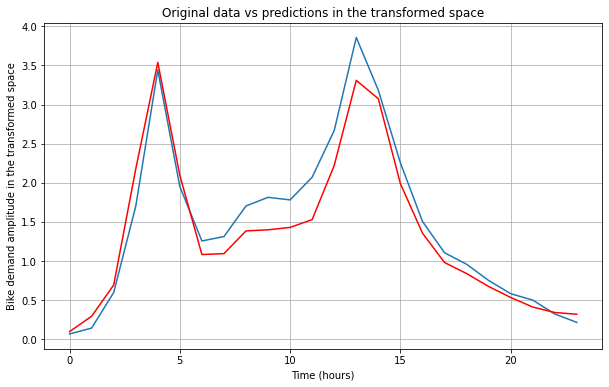

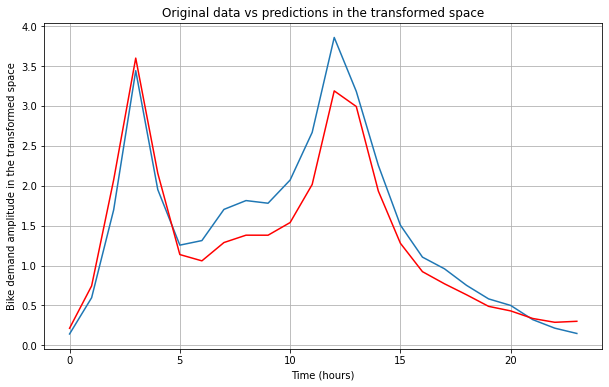

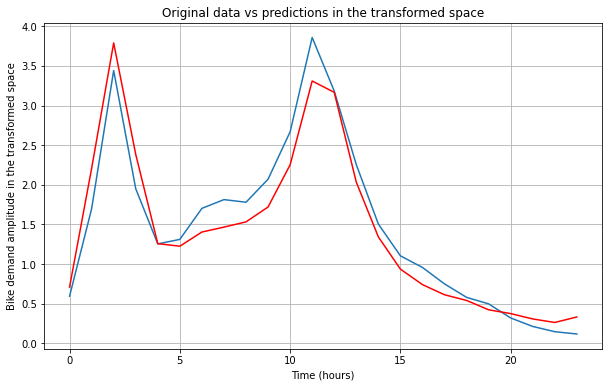

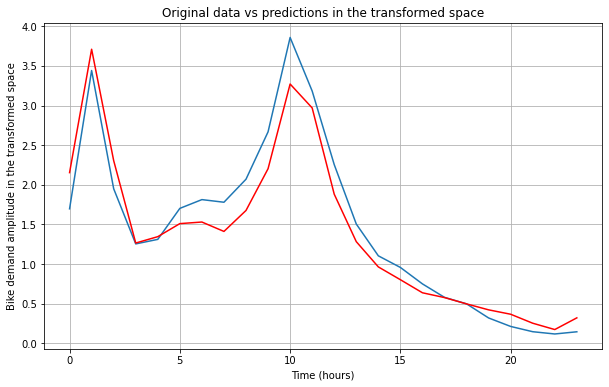

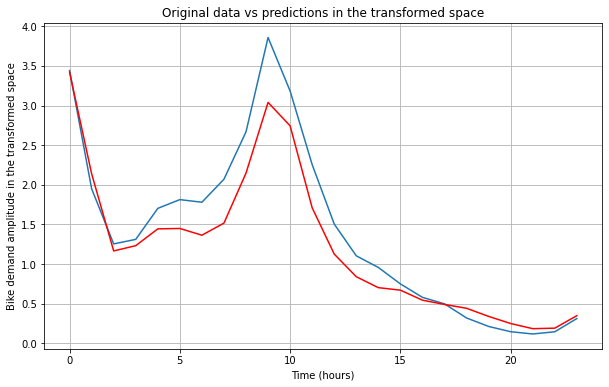

In [87]:
for i in range(0,387):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

In [78]:
y_pred_ = y_pred[0:-23,:]
y_test_ = y_test[0:-23,:]

In [79]:
for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 0.1957180921337819
Train RMSE: 0.2702362255760413
Train RMSE: 0.310100402686849
Train RMSE: 0.3338900124234923
Train RMSE: 0.3467488231615142
Train RMSE: 0.3480406598144268
Train RMSE: 0.3535991191043795
Train RMSE: 0.3523480591704542
Train RMSE: 0.3598671365644495
Train RMSE: 0.38446880055456256
Train RMSE: 0.3931271263039456
Train RMSE: 0.39412779998802894
Train RMSE: 0.3937908365010828
Train RMSE: 0.393748888540672
Train RMSE: 0.3941705286583222
Train RMSE: 0.40324840306991516
Train RMSE: 0.4071069956430855
Train RMSE: 0.40368176762915897
Train RMSE: 0.4121903790149053
Train RMSE: 0.4135660159946941
Train RMSE: 0.4171044160854758
Train RMSE: 0.41468184998699087
Train RMSE: 0.42415575676701145
Train RMSE: 0.43335709661285926


Text(0.5, 1.0, 'Original data vs predictions in the transformed space')

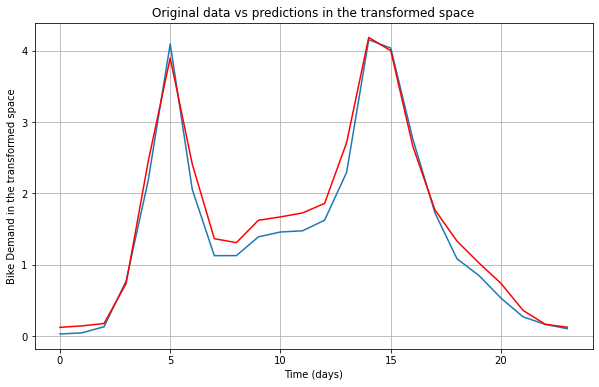

In [ ]:
# Prediction
y_pred = model_2.predict(X_test)

# the_day is the day from which we will study the n_steps_out-th dayS of prediction into 
# the future. Note: The first day start at index 0
the_day = 0
y_pred_days = y_pred[the_day,:]

plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(y_test[the_day,:],label='Orginal data - transformed')
plt.plot(y_pred_days, color='red',label='Predictions - transformed')
plt.xlabel('Time (days)')
plt.ylabel('Bike Demand in the transformed space')
plt.title('Original data vs predictions in the transformed space')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

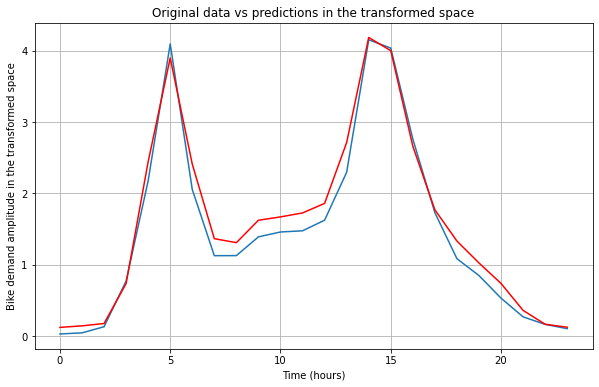

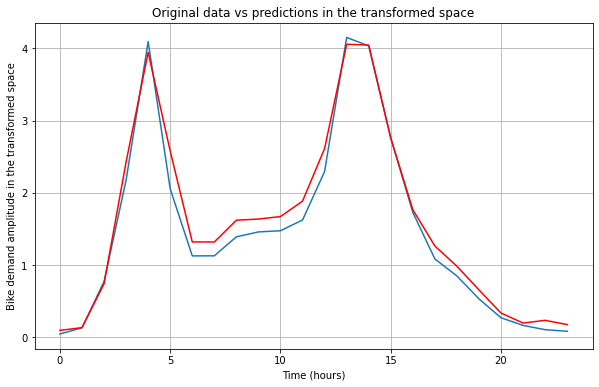

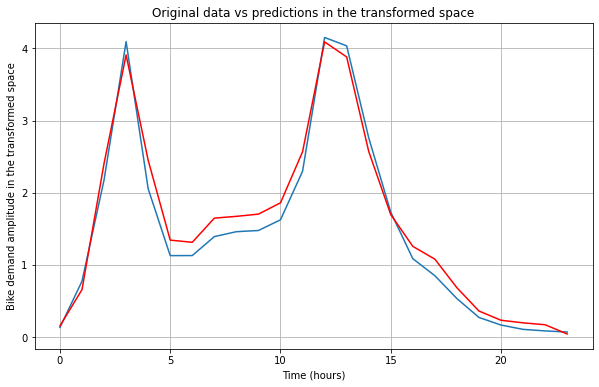

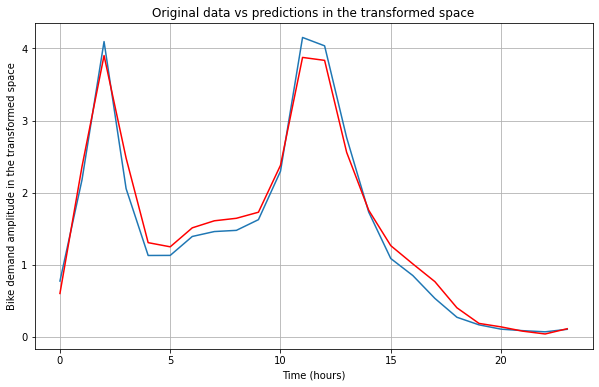

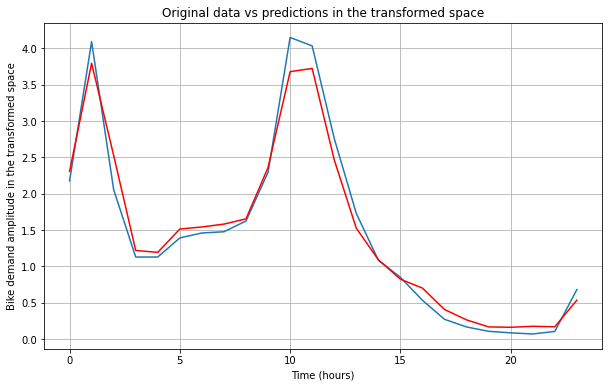

...

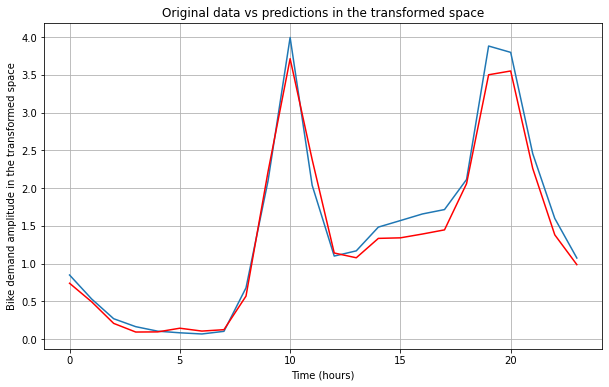

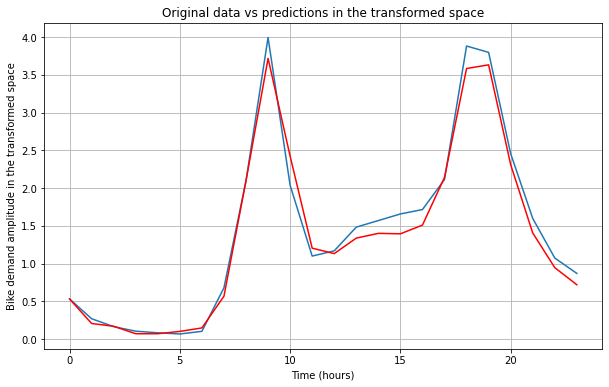

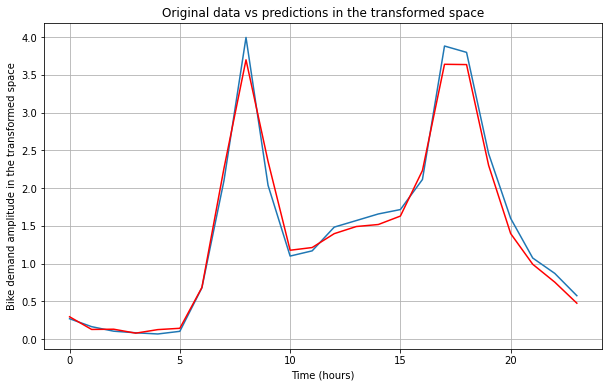

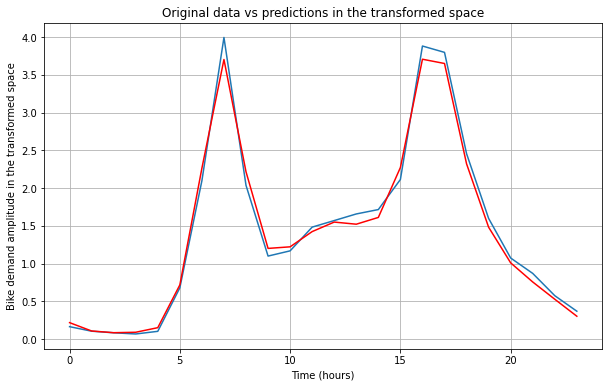

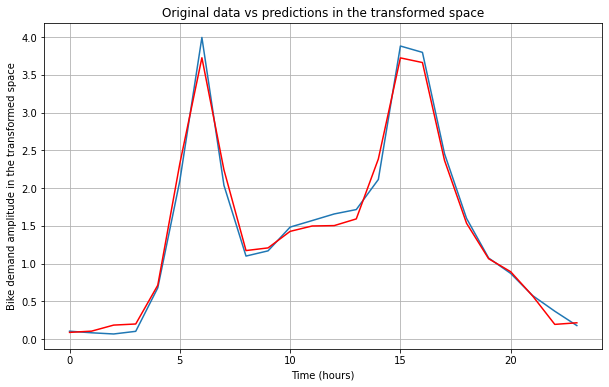

In [ ]:
for i in range(0,24):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

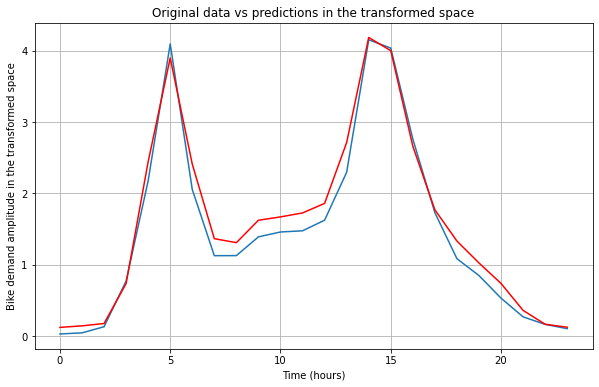

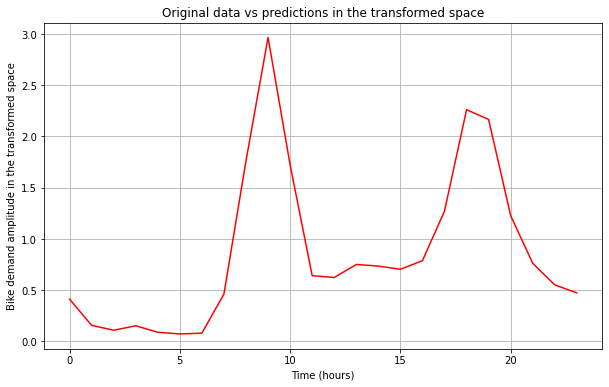

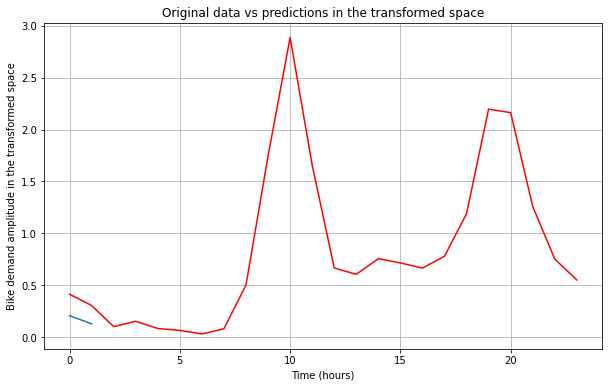

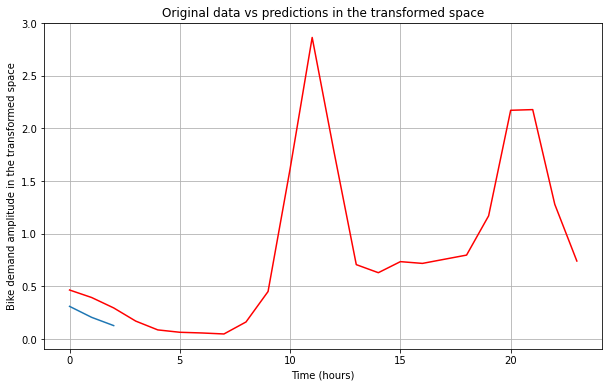

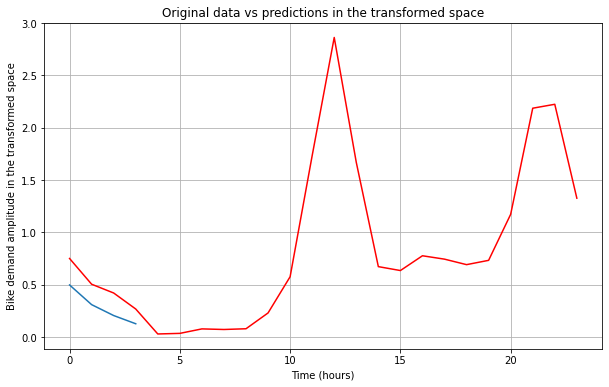

...

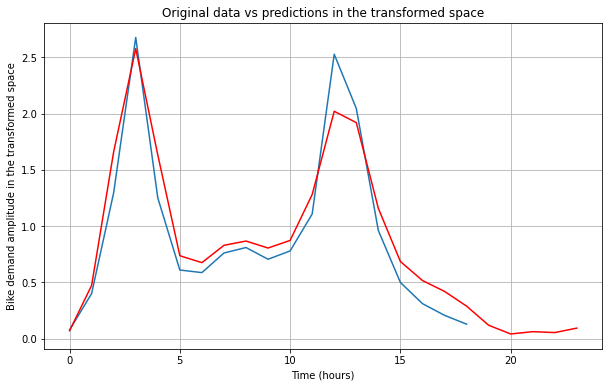

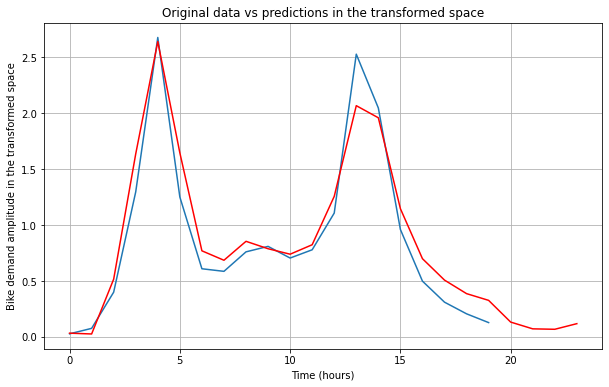

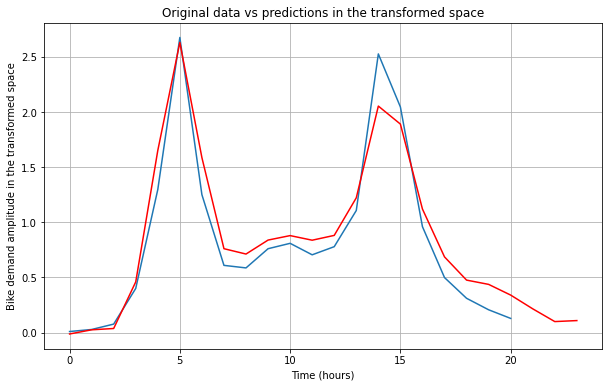

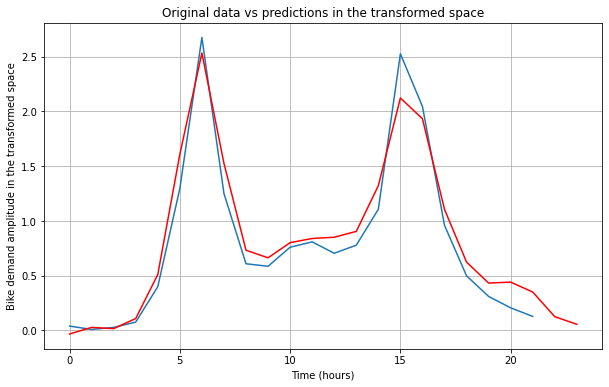

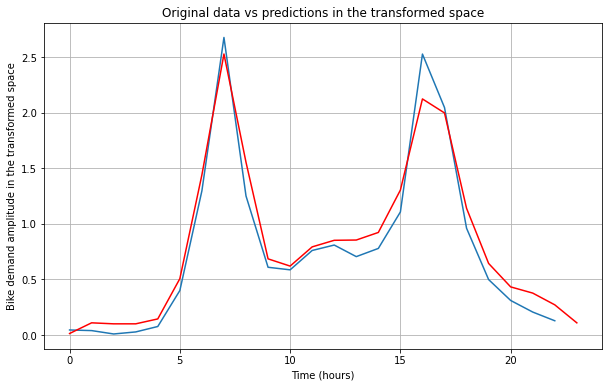

In [ ]:
for i in range(0,24):
  the_hour = -i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

In [ ]:
sample = X_test[i:(i+1)].copy()

pred0 = model_gru.predict(sample)[0][0]
delta = 1e-3
w_in = sample.shape[1]

print("SENSIBILIDAD DE LA PREDICCIÓN A LAS ENTRADAS:\n")
for i,x in enumerate(nombres_series):
    for j in range(w_in):
        sample_pert = sample.copy()
        sample_pert[0,j,i] += delta
        pred_pert = model.predict(sample_pert)[0][0]
        if se_saben_antes[i]:
            print("{} (t-{}) [ADELANTADA]: {:.3f}".format(x, w_in-j, (pred_pert - pred0) / delta))
        else:
            print("{} (t-{}): {:.3f}".format(x, w_in-j, (pred_pert - pred0) / delta))

SENSIBILIDAD DE LA PREDICCIÓN A LAS ENTRADAS:



TypeError: ignored

# CNN-LSTM


In [89]:
# The GRU architecture
regressorGRU = Sequential()
# First GRU layer with Dropout regularisation
regressorGRU.add(GRU(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU.add(Dropout(0.2))
# Second GRU layer
regressorGRU.add(GRU(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU.add(Dropout(0.2))
# Third GRU layer
regressorGRU.add(GRU(units=50, return_sequences=True, input_shape=(lookback, X_train.shape[-1]), activation='tanh'))
regressorGRU.add(Dropout(0.2))
# Fourth GRU layer
regressorGRU.add(GRU(units=50, activation='tanh'))
regressorGRU.add(Dropout(0.2))
# The output layer
regressorGRU.add(Dense(units=time_step))
# Compiling the RNN
regressorGRU.compile(optimizer=optimizer,
                     loss=loss,
                     metrics=['mse'])
# Fitting to the training set
history_regressorGRU = regressorGRU.fit(X_train, y_train, epochs=25, validation_split=0.1, batch_size=32)

Epoch 1/25
391/391 [==============================] - 38s 76ms/step - loss: 0.6440 - mse: 0.6440 - val_loss: 0.4882 - val_mse: 0.4882
Epoch 2/25
391/391 [==============================] - 28s 72ms/step - loss: 0.3742 - mse: 0.3742 - val_loss: 0.3259 - val_mse: 0.3259
Epoch 3/25
391/391 [==============================] - 29s 73ms/step - loss: 0.2998 - mse: 0.2998 - val_loss: 0.2842 - val_mse: 0.2842
Epoch 4/25
391/391 [==============================] - 28s 72ms/step - loss: 0.2583 - mse: 0.2583 - val_loss: 0.2530 - val_mse: 0.2530
Epoch 5/25
391/391 [==============================] - 28s 73ms/step - loss: 0.2380 - mse: 0.2380 - val_loss: 0.2418 - val_mse: 0.2418
Epoch 6/25
391/391 [==============================] - 28s 73ms/step - loss: 0.2223 - mse: 0.2223 - val_loss: 0.2224 - val_mse: 0.2224
Epoch 7/25
391/391 [==============================] - 29s 74ms/step - loss: 0.2081 - mse: 0.2081 - val_loss: 0.2178 - val_mse: 0.2178
Epoch 8/25
391/391 [==============================] - 28s 73ms

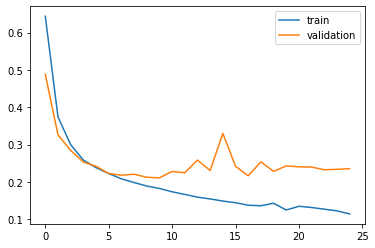

In [90]:
plt.plot(history_regressorGRU.history['loss'], label='train')
plt.plot(history_regressorGRU.history['val_loss'], label='validation')
plt.legend()
plt.show()

In [91]:
y_pred_regressor_gru = regressorGRU.predict(X_test)

y_pred_ = y_pred_regressor_gru [0:-23,:]
y_test_ = y_test[0:-23,:]

for i in range(len(y_pred[0,:])):
  print('Train RMSE:', np.sqrt(mean_squared_error(y_test_[:,i], y_pred_[:,i])))

Train RMSE: 0.4042688295602386
Train RMSE: 0.4177704903729347
Train RMSE: 0.4231894971507141
Train RMSE: 0.43247347417901033
Train RMSE: 0.43774150708553927
Train RMSE: 0.4427674410211132
Train RMSE: 0.45103773093569105
Train RMSE: 0.4540172570750616
Train RMSE: 0.4613863054862458
Train RMSE: 0.46614344357847404
Train RMSE: 0.47304379515302597
Train RMSE: 0.4795461469052225
Train RMSE: 0.48040224220298805
Train RMSE: 0.4815892418017644
Train RMSE: 0.479683597330578
Train RMSE: 0.4848894739253106
Train RMSE: 0.48725593702720577
Train RMSE: 0.4945872300440677
Train RMSE: 0.49371615136178293
Train RMSE: 0.48872351170650163
Train RMSE: 0.48653525448633367
Train RMSE: 0.4876443013191766
Train RMSE: 0.4858908053613041
Train RMSE: 0.4907425214981193


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much

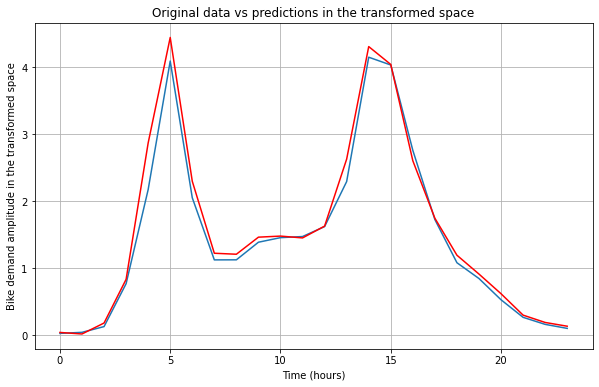

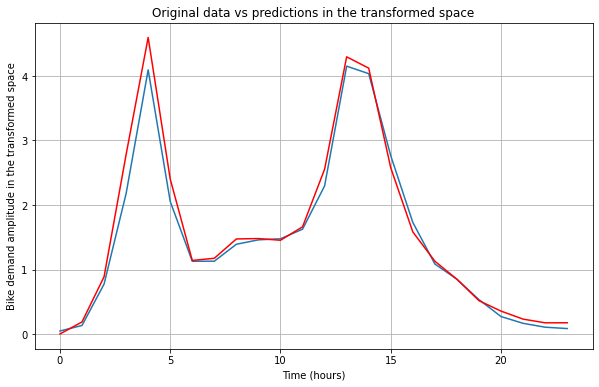

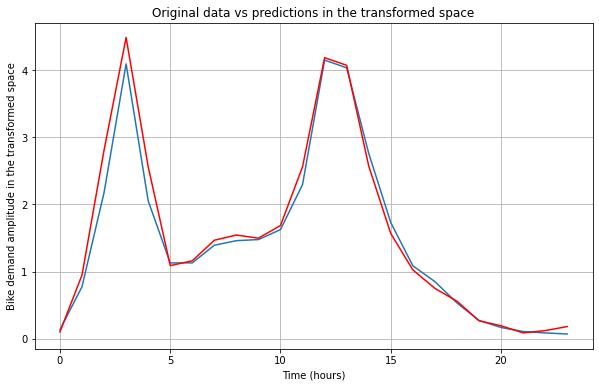

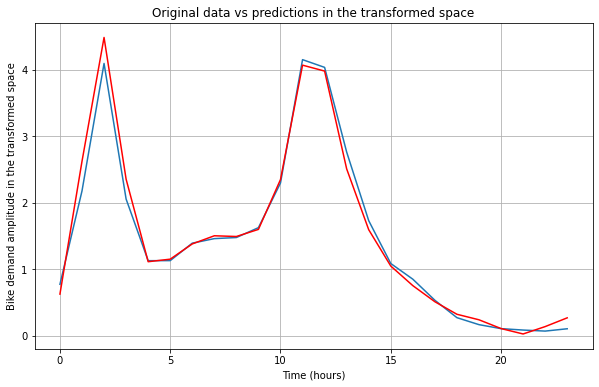

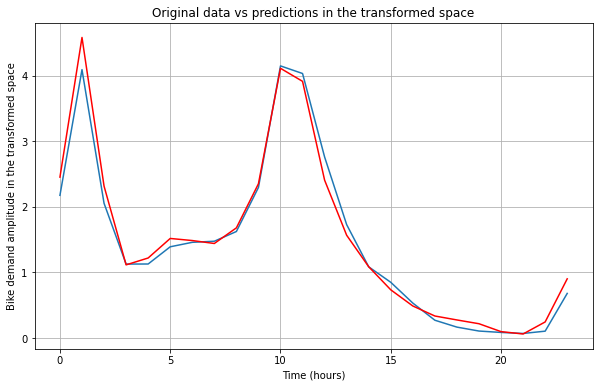

...

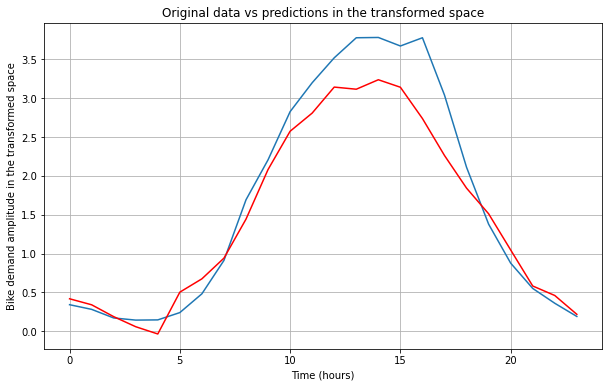

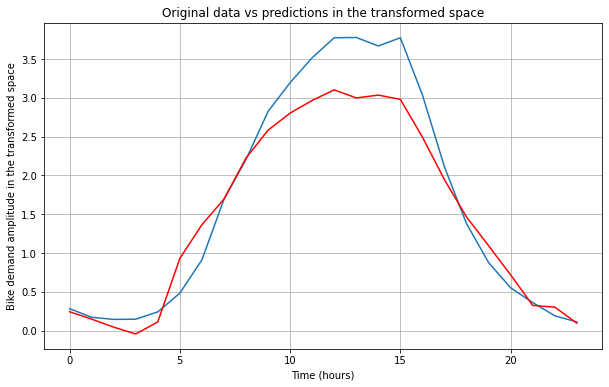

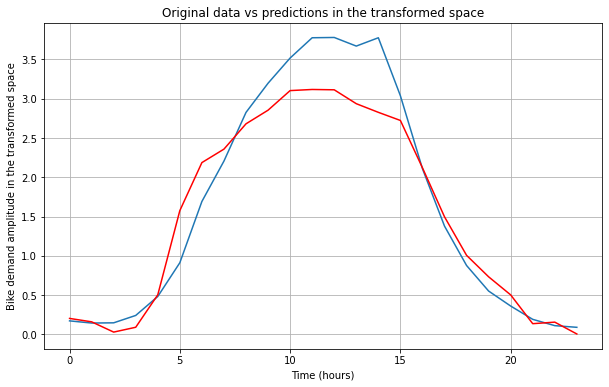

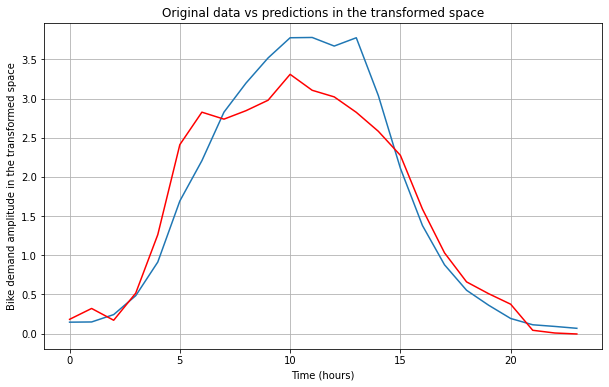

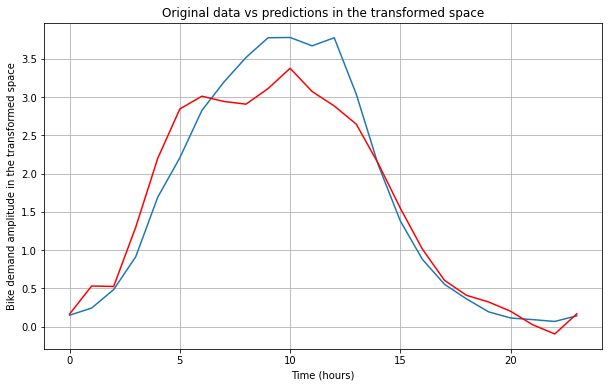

In [92]:
for i in range(0,100):
  the_hour = i
  y_pred_days = y_pred[the_hour,:]
  plt.figure(figsize=(10,6))
  plt.grid(True)
  plt.plot(y_test[the_hour,:],label='Orginal data - transformed')
  plt.plot(y_pred_days, color='red',label='Predictions - transformed')
  plt.xlabel('Time (hours)')
  plt.ylabel('Bike demand amplitude in the transformed space')
  plt.title('Original data vs predictions in the transformed space')

In [93]:
from sklearn.metrics import mean_squared_error, explained_variance_score, max_error

In [95]:
for i in range(len(y_pred[0,:])):
  print('Explained variance score:', explained_variance_score(y_test_[:,i], y_pred_[:,i]))

Explained variance score: 0.8560137625937232
Explained variance score: 0.8439802378744219
Explained variance score: 0.838779781166932
Explained variance score: 0.8312677778952116
Explained variance score: 0.8271865232457938
Explained variance score: 0.8212109764492654
Explained variance score: 0.8139066702779624
Explained variance score: 0.8104467587250713
Explained variance score: 0.8038163620612748
Explained variance score: 0.7994480614302122
Explained variance score: 0.7940172880729786
Explained variance score: 0.7886854065831329
Explained variance score: 0.7873845858668476
Explained variance score: 0.7866962815944043
Explained variance score: 0.7878819232222287
Explained variance score: 0.782289682084579
Explained variance score: 0.7796179749862762
Explained variance score: 0.7729024639540223
Explained variance score: 0.7737676696053831
Explained variance score: 0.7783666529343519
Explained variance score: 0.781352049740407
Explained variance score: 0.781521676936477
Explained vari